<a href="https://colab.research.google.com/github/Ali-Banihashemi/Reinforcement-Learning-RNNs-LSTMs/blob/main/AI-Project3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Artificial Intelligence Course- 2024**

# **Project 3**




In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## **Part I**

As we know in a Q-Learning problem, our goal is to find a policy which leads to a bigger reward in total.

A policy is an instruction which helps the agent choose a single action in every state.

Reward is a signal that we determine to help the agent understand which state is desired and which state is not.


Value iteration is a basic straight-forward algorithm that focuses on optimizing the value function(V).

 Value function is a quality that binds states and actions using Bellman’s equation. Value function basically tells us what is the biggest reward possible in a single state considering all the future possible actions.

  However in the policy iteration, the approach is a bit more greedy. In the first step we choose a random policy and then we start improving it until we find the optimal policy.

  Policy iteration has 3 steps:

  1- Choosing a policy.

  2- Evaluate it.

  3- Imporove it.

  Then we repeat step 2 and 3 until the answer converges into the optimal policy.

  Let's make it clear by an example:

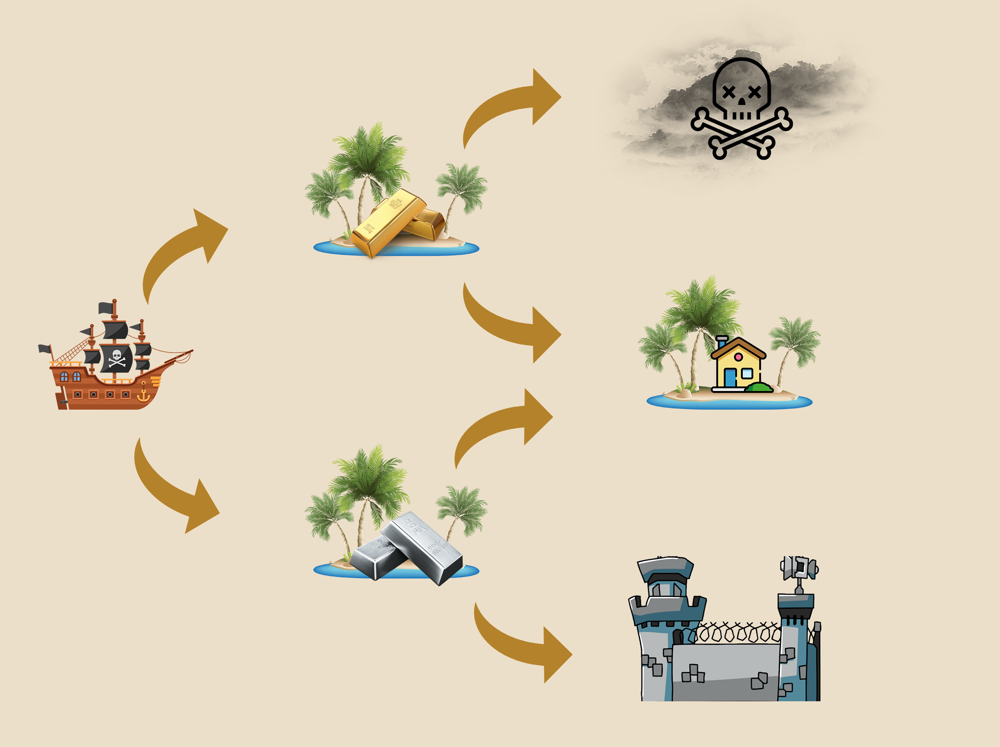

In [ ]:
from IPython.display import Image
Image(filename='/content/drive/MyDrive/AI-Project3/policy1.png',width=700,height=500)

In this example, we have a pirate ship which is looking for a treasure. They are going to go to one of gold or silver island and then come to the home island. However there is a dangerous storm in the north of gold island and there is prison island on the south of silver island. You probably say they should go to north and reach the gold island and then come south to the home island but there is a catch. They possess a broken compass which has the probability of 0.2 to show the wrong direction so they may not want to risk their lives. These being said let's turn our problem into a MDP.

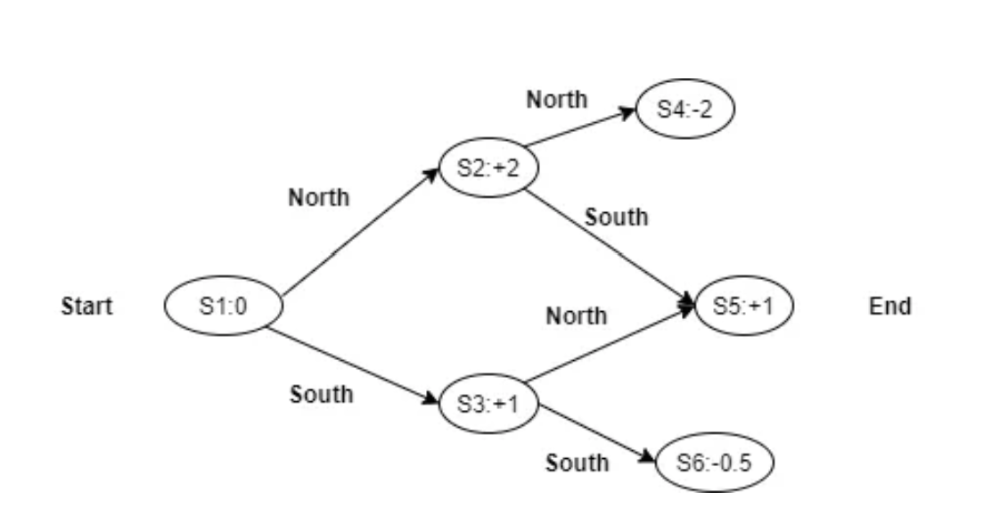

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/policy2.png',width=600,height=300)

As we can see here, we assume reward of reaching gold is 2 and reward of reaching silver is 1 and reward of reaching the home Island in the end is 1. On the other hand reward of facing dangerous storm is -2 and reward of ending up in prison is -0.5. Now we should find a policy which helps the pirates go the optimal way in this problem. We should involve probability in our calculations. As we know the answer without considering probabilities is obvious.

We have two different actions in this problem, we can construct the probability matrix for each of them.

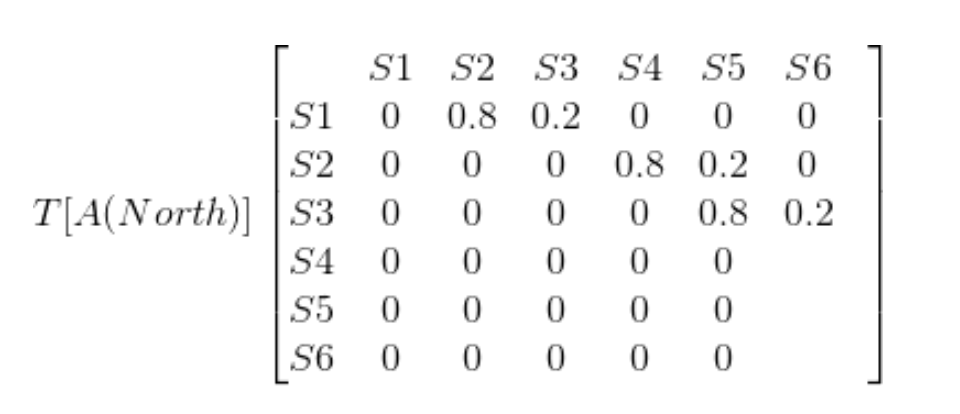

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/policy3.png',width=600,height=250)

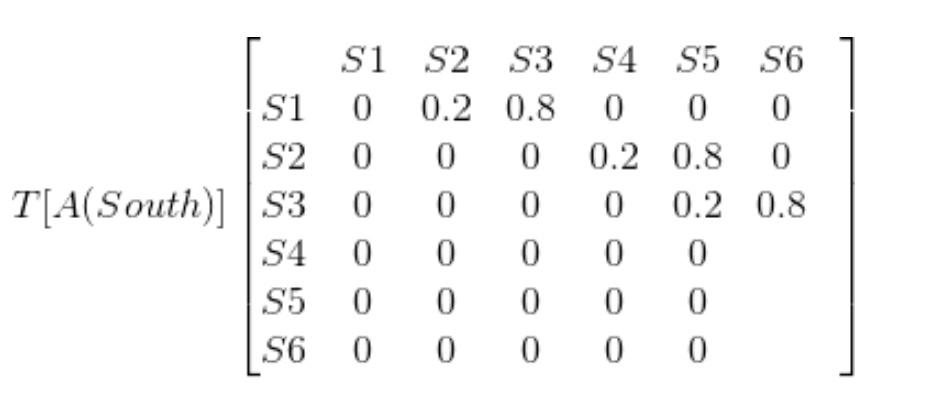

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/policy4.png',width=600,height=250)

We know that there is no actions in states S4 to S6, So we can limit our policy to choosing the righht action in states S1 to S3.

As we mentioned earlier, the first step in the policy iteration is choosing a random policy. So let's suppose our randm policy is:

POLICY = {N,N,N}

which means in every state from S1 to S3 we will choose the north as our action.

Now we should evaluate our policy. As we are in the first episode, the Bellman equation would reduce to V(s) = R(s), where R(s) is the reward for entering a state. So the values for each state is:

V[S1] = 0, V[S2] = 2, V[S3] = 1, V[S4] = -2, V[S5] = 1, V[S6] = -0.5

and that's it for the evaluation part and we should continue with improving this policy.

In this step we should calculate the possible reward of every action in a single state and find the action which is better:

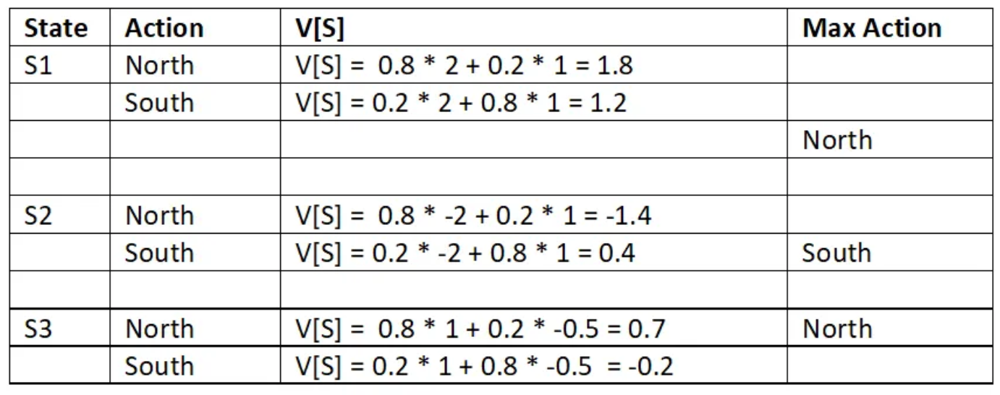

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/policy5.png',width=600,height=250)

As we can see, considering probability and the value function of the future steps, lead to a better unserstanding of optimal action. It's obvious that it is better not to go directly in the storm(choosing north in the S2) and trying to reach the home island. So we update our policy in this step to:

Policy = {N,S,N}

and then we should repeat steps 2 and 3.

Now that we are in the second episode, we can update the value funtions based on the previous values:


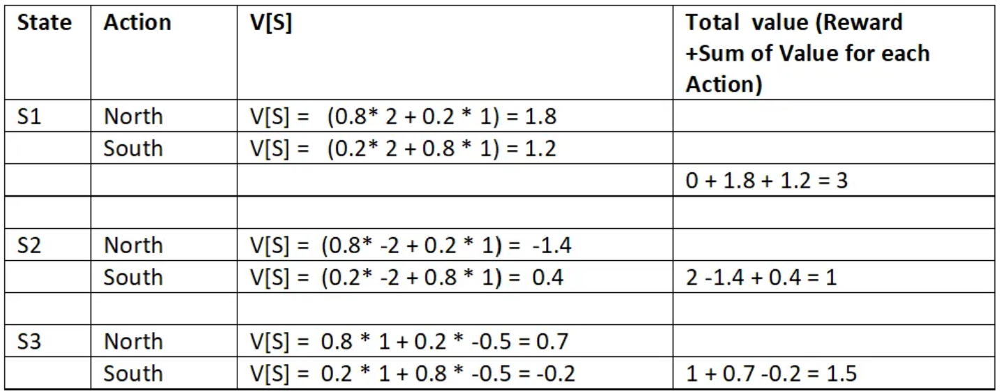

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/policy6.png',width=600,height=250)

There is no states after S4, S5, and S6. However we can calculate S to S3 values based on the future rewards. Here we are having the discount parameter as 1. So the weigths for the instant rewards and te long term rewards are the same. You can see how we update the values based on the future possibilities in the above table. Now we can show the new value funtion as:

V[S1] = 3, V[S2] = 1, V[S3] = 1.5, V[S4] = -2, V[S5] = 1, V[S6] = -0.5

The next step is the policy improvement:

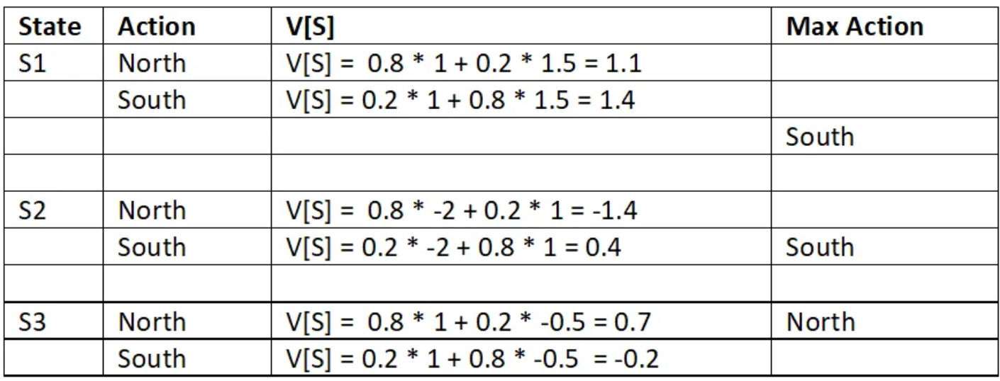

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/policy7.png',width=600,height=250)

Now we are choosing south in the first State as well which implies that pirates should not risk their lives for gold and they should be content with the silver.

The we do the exact two steps for the third episode:

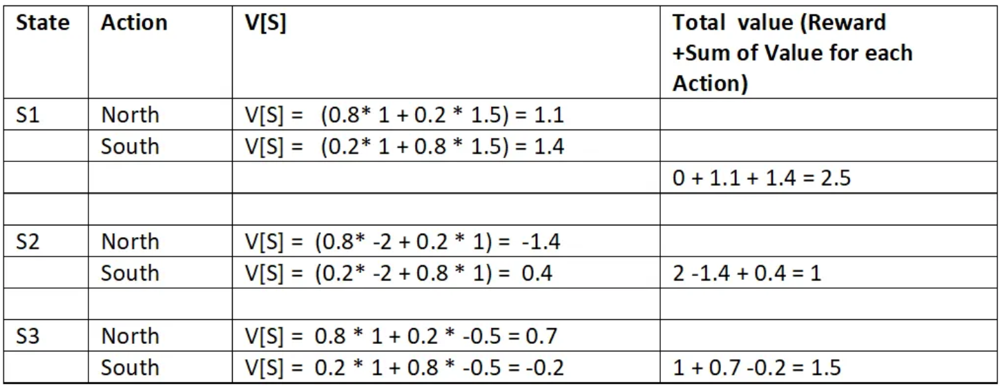

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/policy8.png',width=600,height=250)

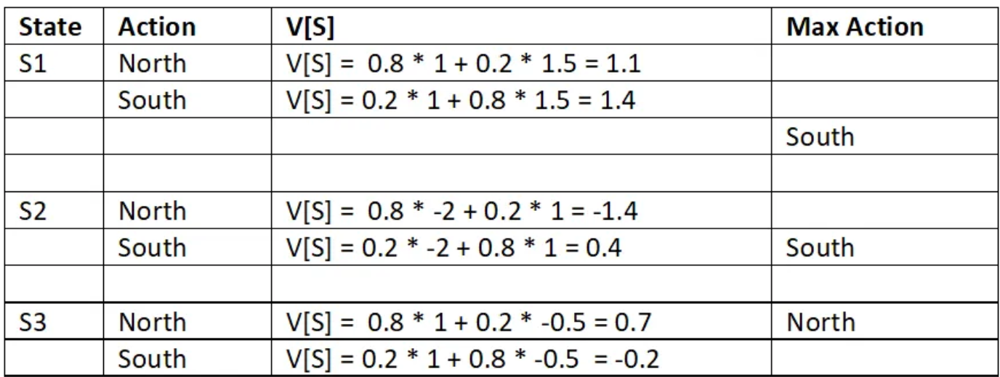

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/policy9.png',width=600,height=250)

As we can see the result is the same as the last iteration which means the policy has converged into the optimal answer.

It's important to emphasis on the role of discount parameter here. In many examples the long term reward is important as well as short term rewards and the opposite is true in many cases as well. In this example where the pirates end is as important as what they achieve if not more. So we are choosing discount parameter as 1. In a chess game the long term reward of winning is the main goal and the short term reward of capturing a piece should not fool the agent to pick the wrong choice.

We should always find a balance between short and long term rewards base on the problem.

Here we are going to talk about how implementation of cartpole games works in action:

Imports: The new thing here is gym which provides us with different reinforcement learning environments.

In [ ]:
import random
import gym
import numpy as np
from collections import deque
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import Nadam
from keras.optimizers import Adam
from IPython.display import HTML
import os

Init: Using gym library we make the Cartpole environment and define state and action size as well as batch size and number of episodes.

In [ ]:
env = gym.make('CartPole-v0')
state_size = env.observation_space.shape[0]
action_size = env.action_space.n
batch_size = 32
n_episodes = 200

/usr/local/lib/python3.10/dist-packages/gym/envs/registration.py:593: UserWarning: WARN: The environment CartPole-v0 is out of date. You should consider upgrading to version `v1`.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(


Output dir: defining output directory to save the weights.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
output_dir = '/content/drive/MyDrive/AI-Project3/Model'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
os.chdir(output_dir)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Constructing agent class: In init we are initializing hyperparameters as well as state and action size. In build model we are making a sequential model as brain of the agent. Remember function will save an experience in the agents memory. Train will train te brain based on an experience. Act will provide a new action based on exploration or prediction. Save and load methods are to save and load model weights.

In [ ]:
class DQNAgent:
    def __init__(self, state_size, action_size):
        self.state_size = state_size
        self.action_size = action_size
        self.memory = deque(maxlen=2000)
        self.gamma = 0.95
        self.epsilon = 1.0
        self.epsilon_decay = 0.995
        self.epsilon_min = 0.01
        self.learning_rate = 0.001
        self.model = self._build_model()
    def _build_model(self):
        model = Sequential()
        model.add(Dense(32, activation='relu', input_dim=self.state_size))
        model.add(Dense(32, activation='relu'))
        model.add(Dense(self.action_size, activation='linear'))
        model.compile(loss='mse',
                      optimizer=Nadam(learning_rate=self.learning_rate))
        return model

    def remember(self, state, action, reward, next_state, done):
        self.memory.append((state, action,
                            reward, next_state, done))

    def train(self, batch_size):
        minibatch = random.sample(self.memory, batch_size)
        for state, action, reward, next_state, done in minibatch:
            target = reward
            if not done:
                target = (reward +
                          self.gamma *
                          np.amax(self.model.predict(next_state)[0]))
            target_f = self.model.predict(state)
            target_f[0][action] = target
            self.model.fit(state, target_f, epochs=1, verbose=0)
        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay

    def act(self, state):
        if np.random.rand() <= self.epsilon:
            return random.randrange(self.action_size)
        act_values = self.model.predict(state)
        return np.argmax(act_values[0])
    def save(self, name):
        self.model.save_weights(name)

    def load(self, name):
        self.model.load_weights(name)

Training: here we are creating an instance of our agent and it will be trained for the number of episodes. In each episode we first reset the environment then until the game gets over our agent will choose an action and we find the consequences of that action using env.step. After that we save tis experience in the memory and if the memory has enough experiences ( > batch_size), we will train the model using these experiences.

In [ ]:
agent = DQNAgent(state_size, action_size)

In [ ]:
for e in range(n_episodes):

    state = env.reset()
    state = np.reshape(state, [1, state_size])

    done = False
    time = 0
    while not done:
        action = agent.act(state)
        next_state, reward, done, _ = env.step(action)
        reward = reward if not done else -10
        next_state = np.reshape(next_state, [1, state_size])
        agent.remember(state, action, reward, next_state, done)
        state = next_state
        if done:
            print("episode: {}/{}, score: {}, e: {:.2}"
                  .format(e, n_episodes-1, time, agent.epsilon))
        time += 1


    if len(agent.memory) > batch_size:
        agent.train(batch_size)

    if e % 50 == 0:
        agent.save(output_dir + "weights_"
                   + '{:04d}'.format(e) + ".hdf5")

/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:241: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):


Streaming output truncated to the last 5000 lines.
1/1 [==============================] - 0s 24ms/step
episode: 153/199, score: 61, e: 0.47
1/1 [==============================] - 0s 24ms/step
episode: 154/199, score: 45, e: 0.46
1/1 [==============================] - 0s 35ms/step
episode: 155/199, score: 45, e: 0.46
1/1 [==============================] - 0s 25ms/step
episode: 156/199, score: 17, e: 0.46
1/1 [==============================] - 0s 29ms/step
episode: 157/199, score: 34, e: 0.46
1/1 [==============================] - 0s 24ms/step
episode: 158/199, score: 199, e: 0.46
1/1 [==============================] - 0s 35ms/step
episode: 159/199, score: 32, e: 0.45
1/1 [==============================] - 0s 26ms/step
episode: 160/199, score: 140, e: 0.45
1/1 [==============================] - 0s 42ms/step
episode: 161/199, score: 69, e: 0.45
1/1 [==============================] - 0s 25ms/step
episode: 162/199, score: 31, e: 0.45
1/1 [==============================] - 0s 23ms/step
episo

Now we should change out hyperparameters to have a better model.

In [ ]:
class DQNAgent2:
    def __init__(self, state_size, action_size):
        self.state_size = state_size
        self.action_size = action_size
        self.memory = deque(maxlen=2000)
        self.gamma = 0.55
        self.epsilon = 1.0
        self.epsilon_decay = 0.995
        self.epsilon_min = 0.01
        self.learning_rate = 0.001
        self.model = self._build_model()
    def _build_model(self):
        model = Sequential()
        model.add(Dense(32, activation='relu', input_dim=self.state_size))
        model.add(Dense(32, activation='relu'))
        model.add(Dense(self.action_size, activation='linear'))
        model.compile(loss='mse',
                      optimizer=Nadam(learning_rate=self.learning_rate))
        return model

    def remember(self, state, action, reward, next_state, done):
        self.memory.append((state, action,
                            reward, next_state, done))

    def train(self, batch_size):
        minibatch = random.sample(self.memory, batch_size)
        for state, action, reward, next_state, done in minibatch:
            target = reward
            if not done:
                target = (reward +
                          self.gamma *
                          np.amax(self.model.predict(next_state)[0]))
            target_f = self.model.predict(state)
            target_f[0][action] = target
            self.model.fit(state, target_f, epochs=1, verbose=0)
        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay

    def act(self, state):
        if np.random.rand() <= self.epsilon:
            return random.randrange(self.action_size)
        act_values = self.model.predict(state)
        return np.argmax(act_values[0])
    def save(self, name):
        self.model.save_weights(name)

    def load(self, name):
        self.model.load_weights(name)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
agent2 = DQNAgent2(state_size, action_size)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
for e in range(n_episodes):
    state = env.reset()
    state = np.reshape(state, [1, state_size])

    done = False
    time = 0
    while not done:
        action = agent2.act(state)
        next_state, reward, done, _ = env.step(action)
        reward = reward if not done else -10
        next_state = np.reshape(next_state, [1, state_size])
        agent2.remember(state, action, reward, next_state, done)
        state = next_state
        if done:
            print("episode: {}/{}, score: {}, e: {:.2}".format(e, n_episodes-1, time, agent2.epsilon))
        time += 1

    if len(agent2.memory) > batch_size:
        agent2.train(batch_size)

    if e % 50 == 0:
        agent2.save(output_dir + "weights_" + '{:04d}'.format(e) + ".hdf5")

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Streaming output truncated to the last 5000 lines.
1/1 [==============================] - 0s 32ms/step
episode: 163/199, score: 44, e: 0.44
1/1 [==============================] - 0s 29ms/step
episode: 164/199, score: 67, e: 0.44
1/1 [==============================] - 0s 29ms/step
episode: 165/199, score: 77, e: 0.44
1/1 [==============================] - 0s 52ms/step
episode: 166/199, score: 114, e: 0.44
1/1 [==============================] - 0s 35ms/step
episode: 167/199, score: 64, e: 0.44
1/1 [==============================] - 0s 26ms/step
episode: 168/199, score: 56, e: 0.43
1/1 [==============================] - 0s 23ms/step
episode: 169/199, score: 54, e: 0.43
1/1 [==============================] - 0s 35ms/step
episode: 170/199, score: 98, e: 0.43
1/1 [==============================] - 0s 28ms/step
episode: 171/199, score: 25, e: 0.43
1/1 [==============================] - 0s 71ms/step
episode: 172/199, score: 199, e: 0.42
1/1 [==============================] - 0s 38ms/step
episo

We can see by a little change in the discount factor our model performs much better.

We probably want to use a known library for the hyperparamete tuning althhough here, we are doing it by ourselves. We're making a new agent class which hyperparameters can be defined in the init function. Then we will loop true all different combinations possible of hyperparameters based on the list for each one and create a new agent and train it. In the end the biggest score average belongs to the best hyperparameters combination.

In [ ]:
class DQNAgent3:
    def __init__(self, state_size, action_size,gamma,epsilon_decay,epsilon_min,learning_rate):
        self.state_size = state_size
        self.action_size = action_size
        self.memory = deque(maxlen=2000)
        self.gamma = gamma
        self.epsilon = 1.0
        self.epsilon_decay = epsilon_decay
        self.epsilon_min = epsilon_min
        self.learning_rate = learning_rate
        self.model = self._build_model()
    def _build_model(self):
        model = Sequential()
        model.add(Dense(32, activation='relu', input_dim=self.state_size))
        model.add(Dense(32, activation='relu'))
        model.add(Dense(self.action_size, activation='linear'))
        model.compile(loss='mse',
                      optimizer=Nadam(learning_rate=self.learning_rate))
        return model

    def remember(self, state, action, reward, next_state, done):
        self.memory.append((state, action,
                            reward, next_state, done))

    def train(self, batch_size):
        minibatch = random.sample(self.memory, batch_size)
        for state, action, reward, next_state, done in minibatch:
            target = reward
            if not done:
                target = (reward +
                          self.gamma *
                          np.amax(self.model.predict(next_state)[0]))
            target_f = self.model.predict(state)
            target_f[0][action] = target
            self.model.fit(state, target_f, epochs=1, verbose=0)
        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay

    def act(self, state):
        if np.random.rand() <= self.epsilon:
            return random.randrange(self.action_size)
        act_values = self.model.predict(state)
        return np.argmax(act_values[0])
    def save(self, name):
        self.model.save_weights(name)

    def load(self, name):
        self.model.load_weights(name)

In [ ]:
gammas = [0.3,0.5,0.7,0.8]
epsilon = 1.0
epsilon_decays = [0.98,0.99,0.995]
epsilon_mins = [0.01,0.02,0.03]
learning_rates = [0.0005,0.001,0.002]

bgamma = 0.3
bepsilon_decay = 0.98
bepsilon_min = 0.01
blearning_rate = 0.0005
bscore = 0

In [ ]:
n_episodes = 20

In [ ]:
for gamma in gammas:
  for epsilon_decay in epsilon_decays:
    for epsilon_min in epsilon_mins:
      for learning_rate in learning_rates:
        new_agent = DQNAgent3(state_size, action_size,gamma,epsilon_decay,epsilon_min,learning_rate)
        sum = 0
        for e in range(n_episodes):

            state = env.reset()
            state = np.reshape(state, [1, state_size])

            done = False
            time = 0
            while not done:
                action = new_agent.act(state)
                next_state, reward, done, _ = env.step(action)
                reward = reward if not done else -10
                next_state = np.reshape(next_state, [1, state_size])
                new_agent.remember(state, action, reward, next_state, done)
                state = next_state
                if done:
                   print("episode: {}/{}, score: {}, e: {:.2}"
                          .format(e, n_episodes-1, time, new_agent.epsilon))
                   sum += time
                time += 1


            if len(new_agent.memory) > batch_size:
                new_agent.train(batch_size)

            if e % 50 == 0:
                new_agent.save(output_dir + "weights_"
                          + '{:04d}'.format(e) + ".hdf5")
        if (bscore<sum/(n_episodes)):
            bscore = sum/(n_episodes)
            bgamma = gamma
            bepsilon_decay = epsilon_decay
            bepsilon_min = epsilon_min
            blearning_rate = learning_rate
bgamma
bepsilon_decay
bepsilon_min
blearning_rate

episode: 0/19, score: 8, e: 1.0
episode: 1/19, score: 33, e: 1.0
1/1 [==============================] - 0s 19ms/step
episode: 2/19, score: 16, e: 0.98
1/1 [==============================] - 0s 16ms/step
episode: 3/19, score: 8, e: 0.96
1/1 [==============================] - 0s 16ms/step
episode: 4/19, score: 20, e: 0.94
1/1 [==============================] - 0s 19ms/step
episode: 5/19, score: 12, e: 0.92
1/1 [==============================] - 0s 16ms/step
episode: 6/19, score: 15, e: 0.9
1/1 [==============================] - 0s 17ms/step
episode: 7/19, score: 39, e: 0.89
1/1 [==============================] - 0s 18ms/step
episode: 8/19, score: 16, e: 0.87
1/1 [==============================] - 0s 33ms/step
episode: 9/19, score: 11, e: 0.85
1/1 [==============================] - 0s 17ms/step
episode: 10/19, score: 14, e: 0.83
1/1 [==============================] - 0s 17ms/step
episode: 11/19, score: 11, e: 0.82
1/1 [==============================] - 0s 17ms/step
episode: 12/19, score: 

KeyboardInterrupt: 

**Imports**

In [ ]:
import numpy as np
import gym
import random

**Creating environment and qtable**

In [ ]:
env = gym.make("FrozenLake-v1",render_mode='human')
action_size = env.action_space.n
state_size = env.observation_space.n
qtable = np.zeros((state_size, action_size))
print(qtable)

[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(


**Defining hyperparameters**

In [ ]:
total_episodes = 15000
learning_rate = 0.8
max_steps = 99
gamma = 0.95
epsilon = 1.0
max_epsilon = 1.0
min_epsilon = 0.01
decay_rate = 0.005

**Training the model in the environment**

In [ ]:
rewards = []

for episode in range(total_episodes):
    state = env.reset()
    step = 0
    done = False
    total_rewards = 0
    for step in range(max_steps):
        exp_exp_tradeoff = random.uniform(0, 1)
        if exp_exp_tradeoff > epsilon:
            action = np.argmax(qtable[state,:])
        else:
            action = env.action_space.sample()

        new_state, reward, done, info = env.step(action)
        qtable[state, action] = qtable[state, action] + learning_rate * (reward + gamma * np.max(qtable[new_state, :]) - qtable[state, action])
        total_rewards += reward
        state = new_state
        if done == True:
            break
    epsilon = min_epsilon + (max_epsilon - min_epsilon)*np.exp(-decay_rate*episode)
    rewards.append(total_rewards)
    print ("Episode: " +  str(episode))

print ("Score over time: " +  str(sum(rewards)/total_episodes))
print(qtable)

/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:241: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):


Episode: 0
Episode: 1
Episode: 2
Episode: 3
Episode: 4
Episode: 5
Episode: 6
Episode: 7
Episode: 8
Episode: 9
Episode: 10
Episode: 11
Episode: 12
Episode: 13
Episode: 14
Episode: 15
Episode: 16
Episode: 17
Episode: 18
Episode: 19
Episode: 20
Episode: 21
Episode: 22
Episode: 23
Episode: 24
Episode: 25
Episode: 26
Episode: 27
Episode: 28
Episode: 29
Episode: 30
Episode: 31
Episode: 32
Episode: 33
Episode: 34
Episode: 35
Episode: 36
Episode: 37
Episode: 38
Episode: 39
Episode: 40
Episode: 41
Episode: 42
Episode: 43
Episode: 44
Episode: 45
Episode: 46
Episode: 47
Episode: 48
Episode: 49
Episode: 50
Episode: 51
Episode: 52
Episode: 53
Episode: 54
Episode: 55
Episode: 56
Episode: 57
Episode: 58
Episode: 59
Episode: 60
Episode: 61
Episode: 62
Episode: 63
Episode: 64
Episode: 65
Episode: 66
Episode: 67
Episode: 68
Episode: 69
Episode: 70
Episode: 71
Episode: 72
Episode: 73
Episode: 74
Episode: 75
Episode: 76
Episode: 77
Episode: 78
Episode: 79
Episode: 80
Episode: 81
Episode: 82
Episode: 83
Ep

KeyboardInterrupt: 

**Using the qtable to choose the actions**

In [ ]:
env.reset()

for episode in range(10):
    state = env.reset()
    step = 0
    done = False
    print("****************************************************")
    print("EPISODE ", episode)

    for step in range(max_steps):
        action = np.argmax(qtable[state,:])
        new_state, reward, done, info = env.step(action)
        if done:
            env.render()
            print("Number of steps", step)
            break
        state = new_state
env.close()

****************************************************
EPISODE  0
Number of steps 16
****************************************************
EPISODE  1
Number of steps 35
****************************************************
EPISODE  2
Number of steps 11
****************************************************
EPISODE  3
Number of steps 23
****************************************************
EPISODE  4
Number of steps 78
****************************************************
EPISODE  5
Number of steps 31
****************************************************
EPISODE  6
Number of steps 32


KeyboardInterrupt: 

## **Part II**

In LSTMs we are passing the previous outputs in the new units in two different paths instead of simply passing each output to the next unit in a basic RNN.

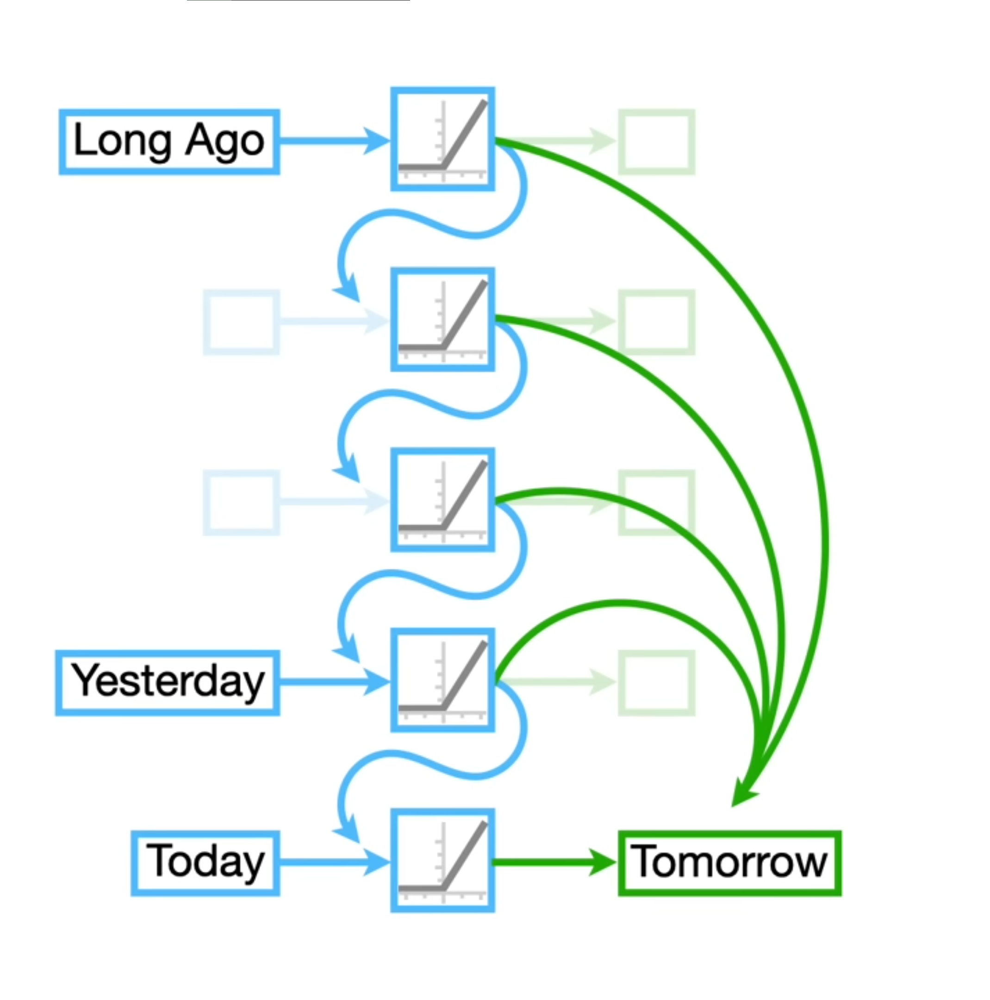

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/lstm0.png',width=400,height=700)

The problem with the basic RNN, is the potential of the gradient to get really big or really small. For instance in a 50 layer RNN if the weights on the feedback loops were 2, the last layer would get a number as big as 2 to power of 50 as it is getting multiplyed by 2 in each feedback loop. On the other hand if the weigths were 0.5, the last layer would get a number as small as 0.5 to the power of 50 and that's the vanishing gradient. So we need an imporovement on these RNNs.

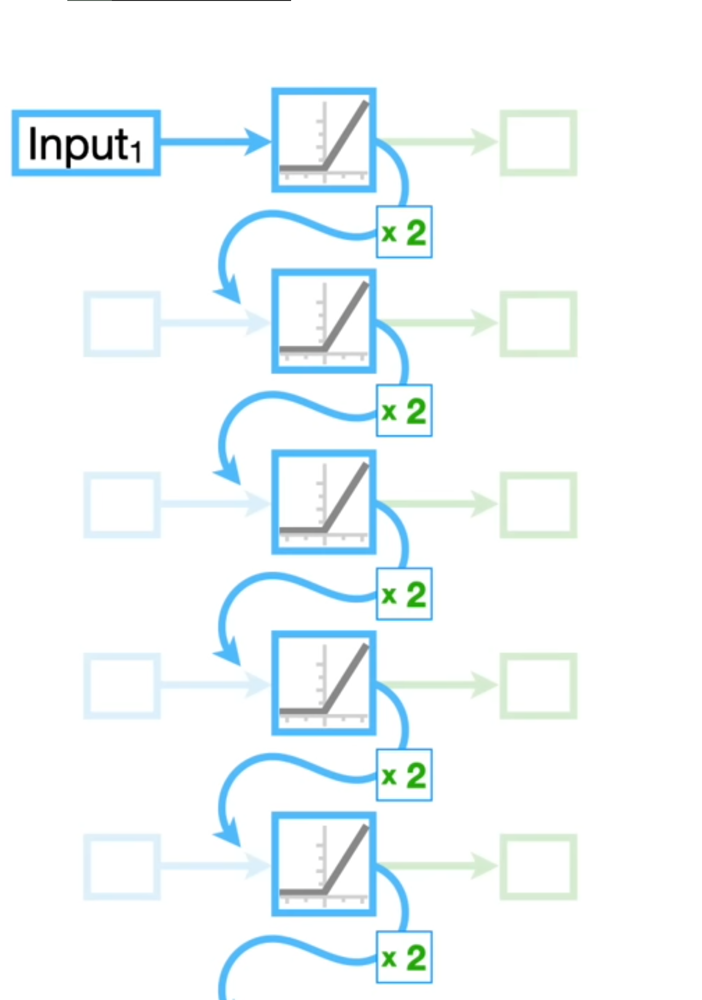

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/RNN1.png',width=400,height=700)

First let's see the structure behind the lstms and then we will tackle the mathematical intuition by an example.

In the following picture we can take a look at the whole structure, we will talk about each part seperately.

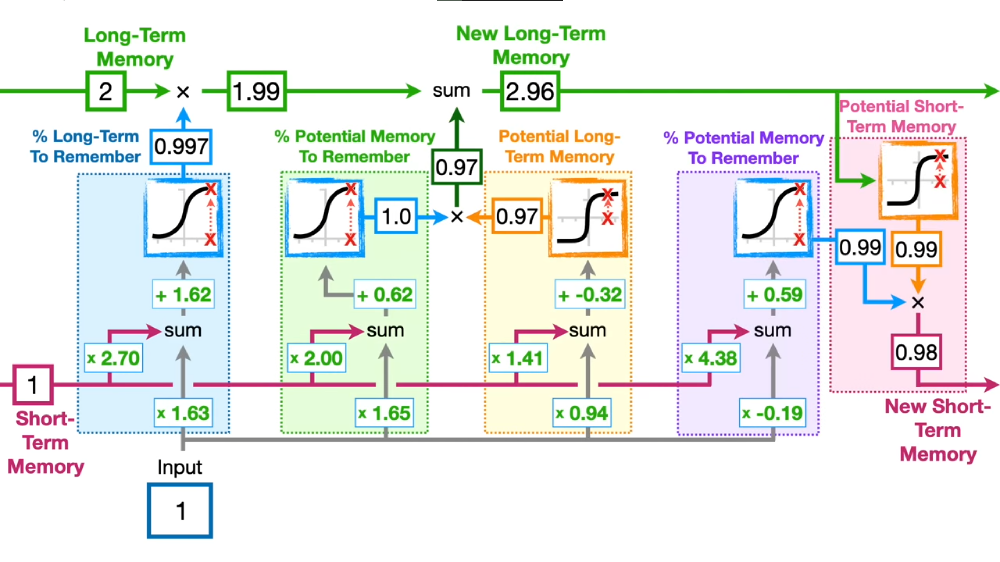

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/lstm1.png',width=700,height=400)

**Forget Gate**

This first part is called a forget gate. Using short term memory and the input in a sigmoid function we can determine how much of the long term memory value we want to remember. The weights in this block will be trained to calculate an ouput weight to be multiplyed by the long term memory.


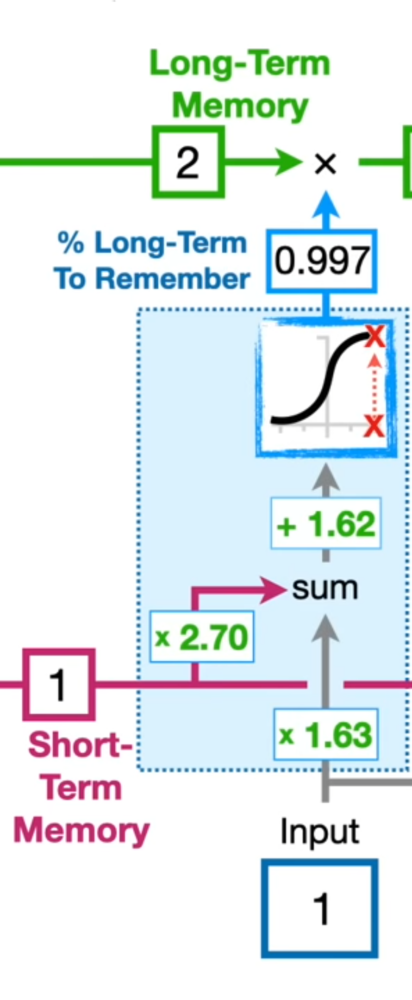

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/lstm2.png',width=300,height=700)

**Input Gate**

These two blocks combined are called the input gate. The block on the right with the help of tanh function will determine how the long term memory should be changed based on the input and the short term memory. The left block will determine a percentage for this change by using a sigmoid function.

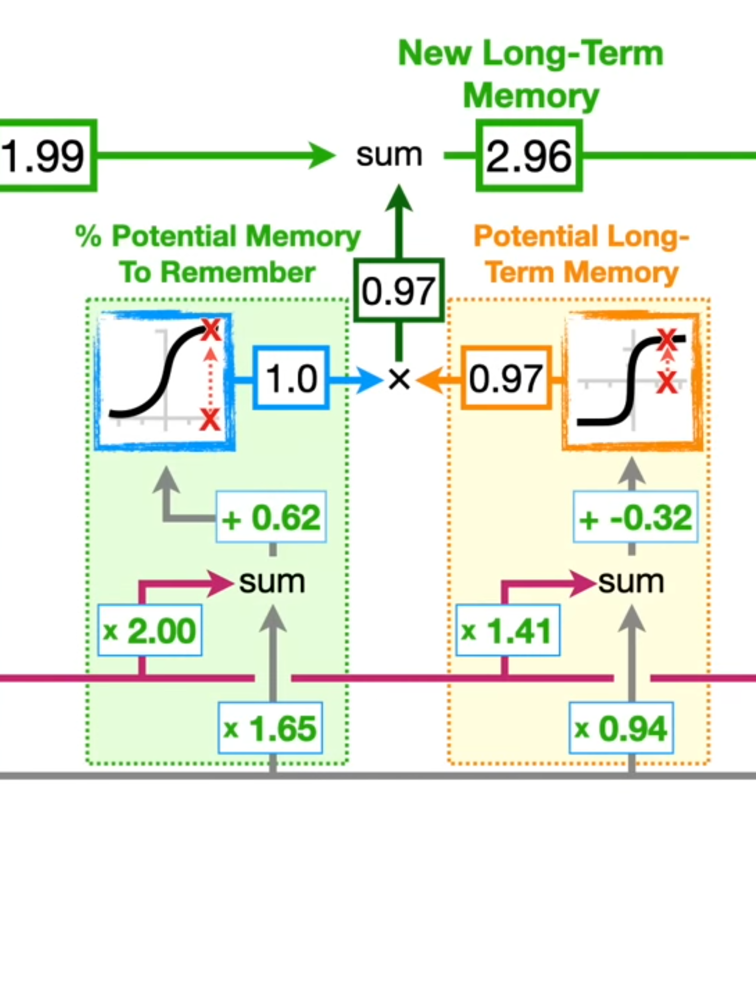

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/lstm3.png',width=400,height=700)

Output Gate

This last part is called the output gate. The left block is working completely the same as the left block in the input gate. It calculates a percentage. The right block using a tanh function and the long term memory as it's input will determine the new short term memory which is the output of this whole part as well. In the last part the long term memory won't be changed.

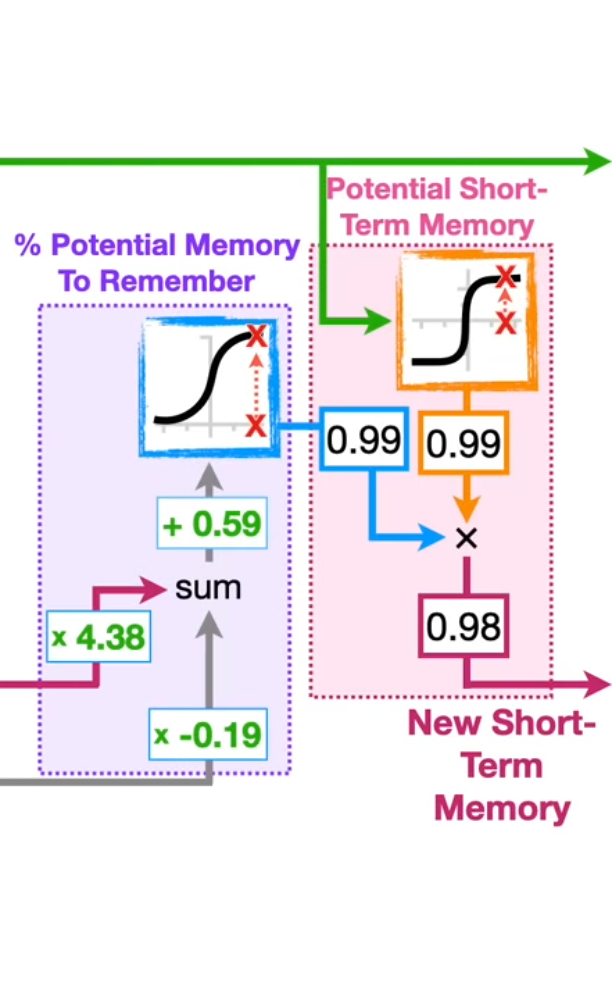

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/lstm4.png',width=400,height=700)

Let's see an example:

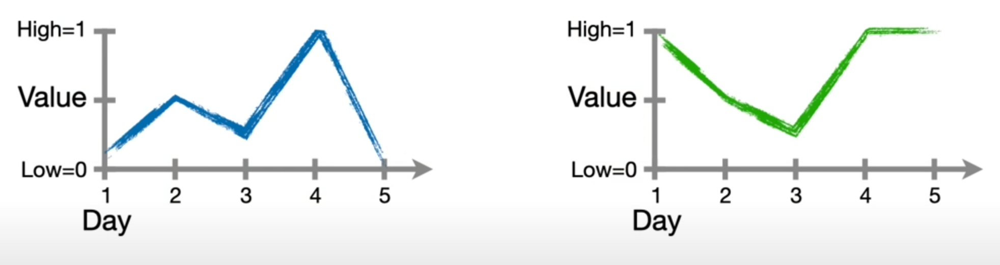

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/lstmEX1.png',width=600,height=200)

In this example we want to predict the value of two companies in the day 5 based on the data on the last 4 days.

If we combine the two plots, we can see that the only difference in the first 4 days is in the day 1.

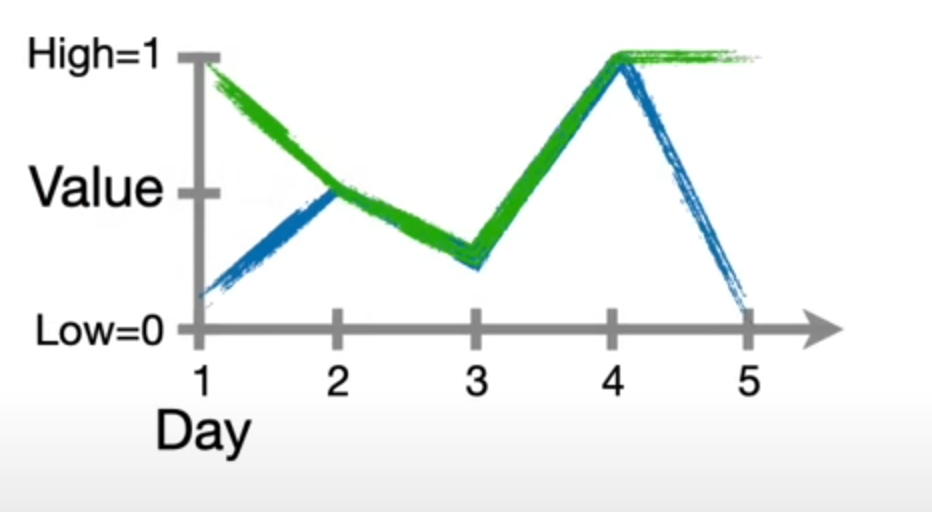

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/lstmEX2.png',width=400,height=200)

LSTM should help us predict the day 5 value correctly by remembering this first day data.

These being said we can input the values for each day to a LSTM block and connect them sequentialy.

After inputing the day 1 value of the first company we can do the math and extract long and short term memory of the first block.

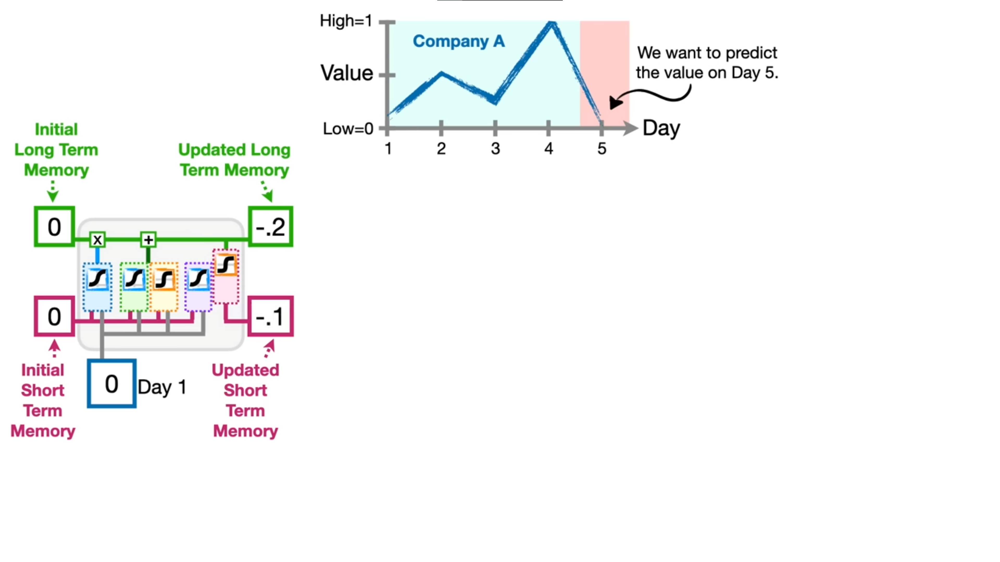

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/lstmEX3.png',width=700,height=400)

How this short and long term output are extracted in this first block? It's just inputing the values in the structure we talked about earlier:

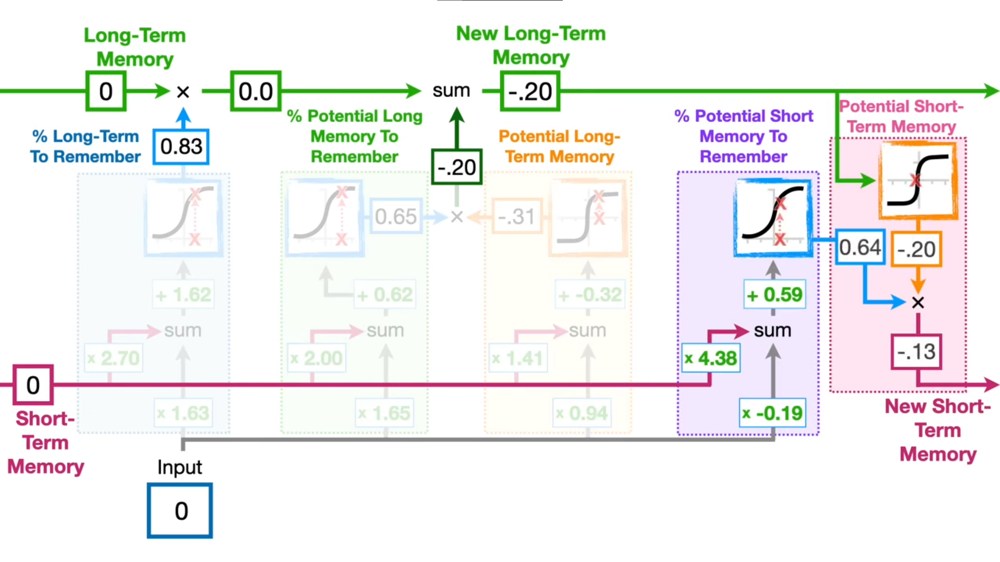

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/lstmEX7.png',width=700,height=400)

Going on with the exact same method we can make more blocks for each day.

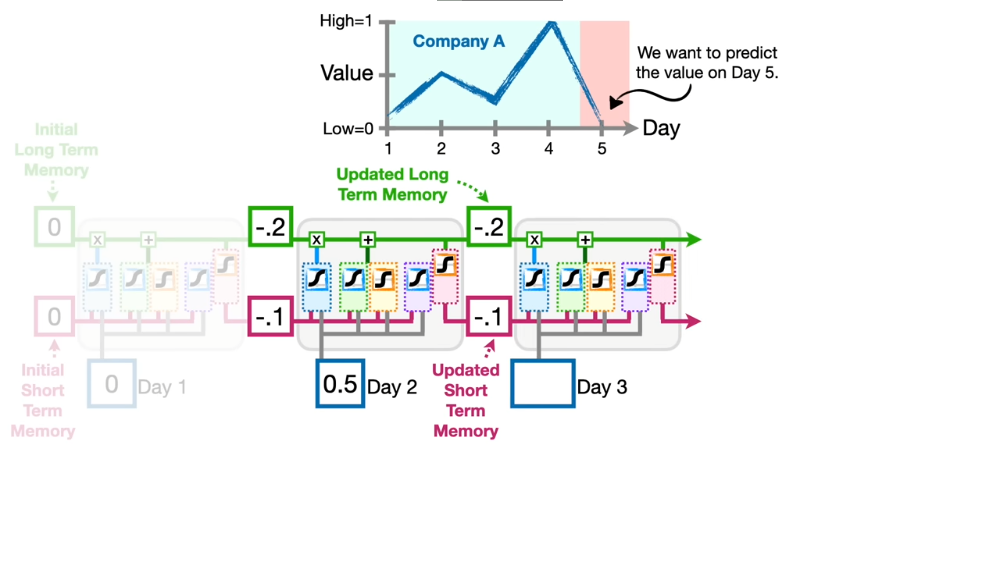

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/lstmEX4.png',width=700,height=400)

In the last step by plugging the day 4 data, the short term memory output will be the model prediction which is correct(coresponding to weights in the model).

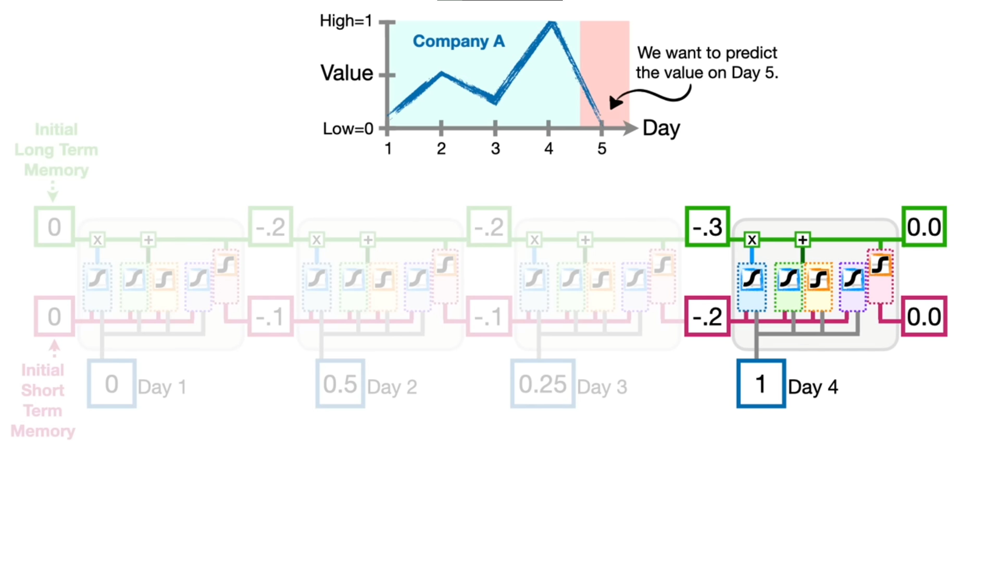

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/lstmEX5.png',width=700,height=400)

We can do the same thing for the other company as well.

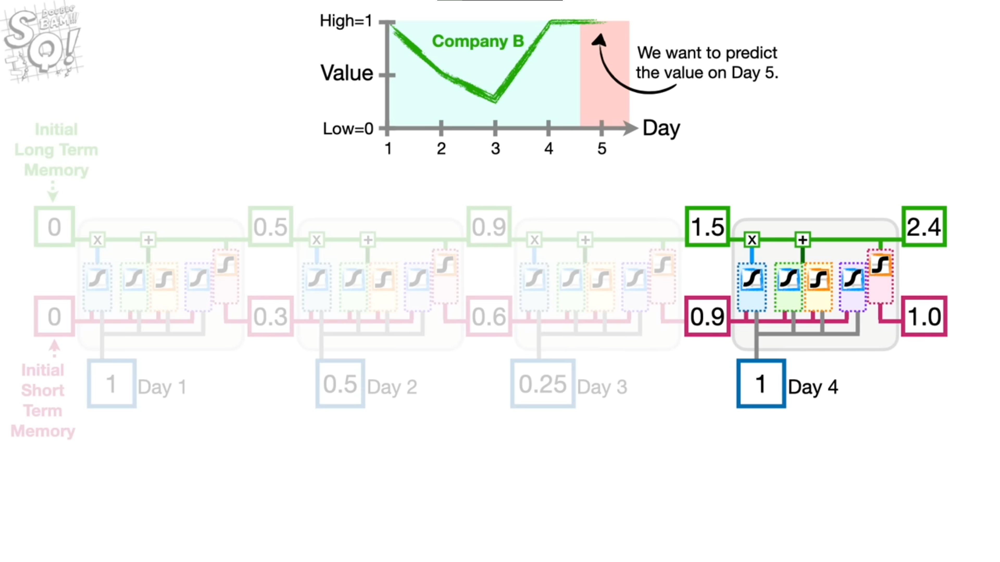

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/lstmEX6.png',width=700,height=400)

Let's now see one RNN and one LTSM implementation and trying to improve them.

#**1.Import libraries**

Simple RNN from keras models is used to construct the RNN model.

I think we have covered all other of these libraries before, zipfile is new which is basicaly to extract zip files.

In [ ]:
import keras
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
import numpy as np
import random
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, SimpleRNN
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
import matplotlib.pyplot as plt


from zipfile import ZipFile
import os

with ZipFile('/content/drive/MyDrive/AI-Project3/jena_climate_2009_2016.zip','r') as zipObj:
  zipObj.extractall('/content/drive/MyDrive/AI-Project3')

#**2.Import our data.**

In [ ]:
csv_path = "/content/drive/MyDrive/AI-Project3/jena_climate_2009_2016.csv"

df = pd.read_csv(csv_path)

In [ ]:
df.head()

,Date Time,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
0,01.01.2009 00:10:00,996.52,-8.02,265.40,-8.90,93.3,3.33,3.11,0.22,1.94,3.12,1307.75,1.03,1.75,152.3
1,01.01.2009 00:20:00,996.57,-8.41,265.01,-9.28,93.4,3.23,3.02,0.21,1.89,3.03,1309.80,0.72,1.50,136.1
2,01.01.2009 00:30:00,996.53,-8.51,264.91,-9.31,93.9,3.21,3.01,0.20,1.88,3.02,1310.24,0.19,0.63,171.6
3,01.01.2009 00:40:00,996.51,-8.31,265.12,-9.07,94.2,3.26,3.07,0.19,1.92,3.08,1309.19,0.34,0.50,198.0
4,01.01.2009 00:50:00,996.51,-8.27,265.15,-9.04,94.1,3.27,3.08,0.19,1.92,3.09,1309.00,0.32,0.63,214.3


#**3. The next step is to delete all columns other than the temperature, as we are building a univariate model. Keeping only the temperature data.**

In [ ]:
df = df[['T (degC)']]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
df.head()

,T (degC)
0,-8.02
1,-8.41
2,-8.51
3,-8.31
4,-8.27


#**4. We apply the min-max scaler.**

In [ ]:
scaler = MinMaxScaler()
df = pd.DataFrame(scaler.fit_transform(df), columns = ['T'])

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


# **5. Data Prepration**

We are simply making the data and predicting datasets. Data includes some lists with length of 3*72 each acting as a single data point. Using that we want to predict 72 datas in the future so our prediction list includes lists of length 72.

We extract as many 4*72 datas as possible then the model will use the first 3 times 72 datas to predict the 72 last datas.

In [ ]:
ylist = list(df['T'])

n_future = 72
n_past = 3*72
total_period = 4*72

idx_end = len(ylist)
idx_start = idx_end - total_period

X_new = []
y_new = []
while idx_start > 0:
  x_line = ylist[idx_start:idx_start+n_past]
  y_line = ylist[idx_start+n_past:idx_start+total_period]

  X_new.append(x_line)
  y_new.append(y_line)

  idx_start = idx_start - 1



X_new = np.array(X_new)
y_new = np.array(y_new)

#**6.We do train test split.**

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_new, y_new, test_size=0.10, random_state=42)

In [ ]:
X_train.shape

(378236, 216)

#**7.It takes a long time to run this model. The batch size of 2000 is provided for demonstration purposes. But you need to put a much smaller batch size. Note that The SimpleRNN layer needs an input format that is 3D, and the shape has to correspond to (n_samples, n_timesteps, n_features). This can be obtained using reshape.**

In [ ]:
batch_size = 100

n_samples = X_train.shape[0]
n_timesteps = X_train.shape[1]
n_steps = y_train.shape[1]
n_features = 1

X_train_rs = X_train.reshape(n_samples, n_timesteps, n_features )

X_test_rs = X_test.reshape(X_test.shape[0], n_timesteps, n_features )

#**8.We parameterize a small network with SimpleRNN.**
Line 1: -------
Line 2: -------
Line 3:-------

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn (SimpleRNN)      (None, 216, 8)            80        
                                                                 
 simple_rnn_1 (SimpleRNN)    (None, 216, 8)            136       
                                                                 
 simple_rnn_2 (SimpleRNN)    (None, 8)                 136       
                                                                 
 dense (Dense)               (None, 72)                648       
                                                                 
Total params: 1000 (3.91 KB)
Trainable params: 1000 (3.91 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/5
3026/3026 [==============================] - 426s 140ms/step - loss: 0.0472 - mean_absolute_error: 0.0472 - val_loss: 0.0435 - val_mean_absolute_e

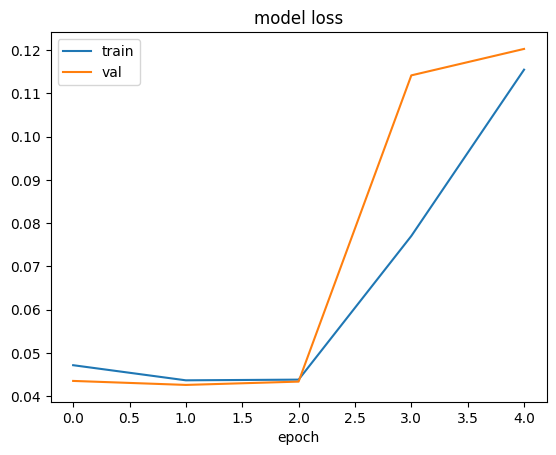

In [ ]:
random.seed(42)

simple_model = Sequential([
  SimpleRNN(8, activation='tanh',input_shape=(n_timesteps, n_features), return_sequences=True),
  SimpleRNN(8, activation='tanh', return_sequences = True),
  SimpleRNN(8, activation='tanh'),
  Dense(y_train.shape[1]),
])

simple_model.summary()

simple_model.compile(
  optimizer=tf.keras.optimizers.Adam(learning_rate=0.01),
  loss='mean_absolute_error',
  metrics=['mean_absolute_error'],
)

smod_history = simple_model.fit(X_train_rs, y_train,
          validation_split=0.2,
          epochs=5,
          batch_size=batch_size,
          shuffle = True
)

preds = simple_model.predict(X_test_rs)



plt.plot(smod_history.history['loss'])
plt.plot(smod_history.history['val_loss'])
plt.title('model loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

In [ ]:
print(r2_score(preds, y_test))

-8846545.116152434


We should change the number of epochs based on this graph.

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_3 (SimpleRNN)    (None, 216, 8)            80        
                                                                 
 simple_rnn_4 (SimpleRNN)    (None, 216, 8)            136       
                                                                 
 simple_rnn_5 (SimpleRNN)    (None, 8)                 136       
                                                                 
 dense_1 (Dense)             (None, 72)                648       
                                                                 
Total params: 1000 (3.91 KB)
Trainable params: 1000 (3.91 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/2
3026/3026 [==============================] - 425s 139ms/step - loss: 0.0472 - mean_absolute_error: 0.0472 - val_loss: 0.0436 - val_mean_absolute

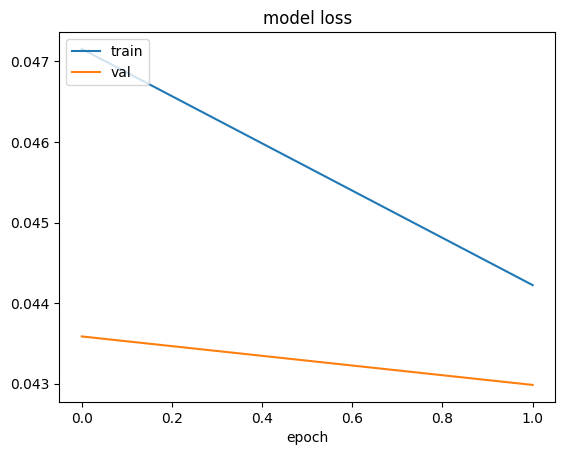

In [ ]:
random.seed(42)

simple_model = Sequential([
  SimpleRNN(8, activation='tanh',input_shape=(n_timesteps, n_features), return_sequences=True),
  SimpleRNN(8, activation='tanh', return_sequences = True),
  SimpleRNN(8, activation='tanh'),
  Dense(y_train.shape[1]),
])

simple_model.summary()

simple_model.compile(
  optimizer=tf.keras.optimizers.Adam(learning_rate=0.01),
  loss='mean_absolute_error',
  metrics=['mean_absolute_error'],
)

smod_history = simple_model.fit(X_train_rs, y_train,
          validation_split=0.2,
          epochs=2,
          batch_size=batch_size,
          shuffle = True
)

preds = simple_model.predict(X_test_rs)



plt.plot(smod_history.history['loss'])
plt.plot(smod_history.history['val_loss'])
plt.title('model loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

In [ ]:
print(r2_score(preds, y_test))

0.7151384619304688


#**9.A simple architecture with 1 Gated Recurrent Unit (GRU) layer.**

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 8)                 264       
                                                                 
 dense_1 (Dense)             (None, 72)                648       
                                                                 
Total params: 912 (3.56 KB)
Trainable params: 912 (3.56 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/5
152/152 [==============================] - 6s 27ms/step - loss: 0.0600 - mean_absolute_error: 0.0600 - val_loss: 0.0476 - val_mean_absolute_error: 0.0476
Epoch 2/5
152/152 [==============================] - 3s 23ms/step - loss: 0.0433 - mean_absolute_error: 0.0433 - val_loss: 0.0331 - val_mean_absolute_error: 0.0331
Epoch 3/5
152/152 [==============================] - 4s 27ms/step - loss: 0.0307 - mean_abso

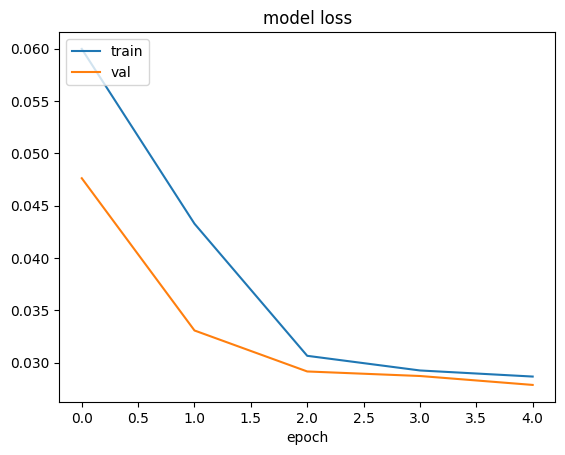

In [ ]:
random.seed(42)
from tensorflow.keras.layers import GRU

simple_model = Sequential([
  GRU(8, activation='tanh',input_shape=(n_timesteps, n_features)),
  Dense(y_train.shape[1]),
])

simple_model.summary()

simple_model.compile(
  optimizer=tf.keras.optimizers.Adam(learning_rate=0.1),
  loss='mean_absolute_error',
  metrics=['mean_absolute_error'],
)

smod_history = simple_model.fit(X_train_rs, y_train,
          validation_split=0.2,
          epochs=5,
          batch_size=batch_size,
          shuffle = True
)

preds = simple_model.predict(X_test_rs)



plt.plot(smod_history.history['loss'])
plt.plot(smod_history.history['val_loss'])
plt.title('model loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

In [ ]:
print(r2_score(preds, y_test))

0.9120883477204715


#**10.This is a  more complex network with three layers of Gated Recurrent Unit (GRU).**

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_1 (GRU)                 (None, 216, 10)           390       
                                                                 
 gru_2 (GRU)                 (None, 216, 10)           660       
                                                                 
 gru_3 (GRU)                 (None, 10)                660       
                                                                 
 dense_2 (Dense)             (None, 72)                792       
                                                                 
Total params: 2502 (9.77 KB)
Trainable params: 2502 (9.77 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/5
152/152 [==============================] - 14s 53ms/step - loss: 0.1934 - mean_absolute_error: 0.1934 - val_loss: 0.0518 - val_mean_absolute_err

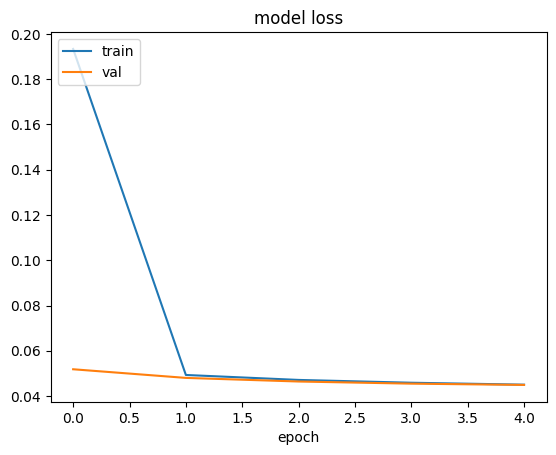

In [ ]:
random.seed(42)

simple_model = Sequential([
   GRU(10, activation='tanh',input_shape=(n_timesteps, n_features), return_sequences=True),
    GRU(10, activation='tanh', return_sequences=True),
    GRU(10, activation='tanh'),
  Dense(y_train.shape[1]),
])

simple_model.summary()

simple_model.compile(
  optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
  loss='mean_absolute_error',
  metrics=['mean_absolute_error'],
)

smod_history = simple_model.fit(X_train_rs, y_train,
          validation_split=0.2,
          epochs=5,
          batch_size=batch_size,
          shuffle = True
)

preds = simple_model.predict(X_test_rs)



plt.plot(smod_history.history['loss'])
plt.plot(smod_history.history['val_loss'])
plt.title('model loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

In [ ]:
print(r2_score(preds, y_test))

0.6811969695969905


And here we have the lstm implementation.

#**1. Import libraries.**

In [ ]:
import pandas
import matplotlib.pyplot as plt
import numpy
import matplotlib.pyplot as plt
import pandas
import math
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
import numpy as np

# **2. We normalize the dataset and do train and test split.**

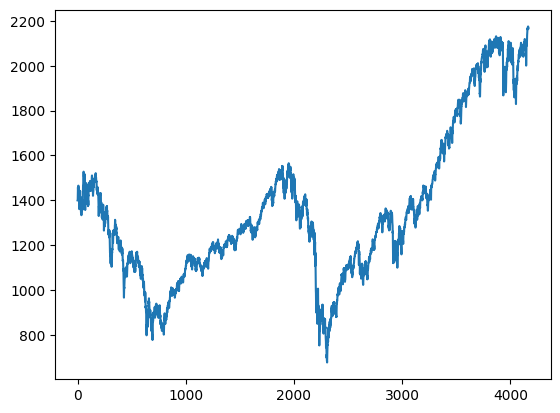

2791 1376


In [ ]:
dataset = pandas.read_csv('/content/drive/MyDrive/AI-Project3/sp500.csv', usecols=[0], engine='python', skipfooter=3)
plt.plot(dataset)
plt.show()

scaler = MinMaxScaler(feature_range=(0, 1))
dataset = scaler.fit_transform(dataset)

train_size = int(len(dataset) * 0.67)
test_size = len(dataset) - train_size
train, test = dataset[0:train_size,:], dataset[train_size:len(dataset),:]
print(len(train), len(test))

In [ ]:
print(dataset)

[[0.48240909]
 [0.48420417]
 [0.48509838]
 ...
 [0.99562893]
 [0.99609603]
 [0.99436106]]


# **3. We convert an array of values into a timeseries data.**

In [ ]:
def create_dataset(dataset, look_back=1):
	dataX, dataY = [], []
	for i in range(len(dataset)-look_back-1):
		a = dataset[i:(i+look_back), 0]
		dataX.append(a)
		dataY.append(dataset[i + look_back, 0])
	return np.array(dataX), np.array(dataY)

In [ ]:
look_back = 1
trainX, trainY = create_dataset(train, look_back)
testX, testY = create_dataset(test, look_back)

In [ ]:
trainX.shape

(2789, 1)

# **4. We reshape input to be [samples, time steps, features].**

In [ ]:

trainX = np.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))
testX = np.reshape(testX, (testX.shape[0], 1, testX.shape[1]))

# **5.We create and fit the LSTM network.**

In [ ]:
model = Sequential()
model.add(LSTM(4, input_shape=(1, look_back)))
model.add(Dense(1))
model.summary()
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(trainX, trainY, epochs=100, batch_size=10, verbose=2)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 4)                 96        
                                                                 
 dense (Dense)               (None, 1)                 5         
                                                                 
Total params: 101 (404.00 Byte)
Trainable params: 101 (404.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/100
279/279 - 10s - loss: 0.0317 - 10s/epoch - 35ms/step
Epoch 2/100
279/279 - 1s - loss: 0.0062 - 718ms/epoch - 3ms/step
Epoch 3/100
279/279 - 1s - loss: 0.0040 - 779ms/epoch - 3ms/step
Epoch 4/100
279/279 - 1s - loss: 0.0020 - 770ms/epoch - 3ms/step
Epoch 5/100
279/279 - 1s - loss: 7.5063e-04 - 707ms/epoch - 3ms/step
Epoch 6/100
279/279 - 1s - loss: 2.5529e-04 - 798ms/epoch - 3ms/step
Epoch 7/100
279/

#**6.We rescale predicted values and compute the root mean squared error.**

In [ ]:
trainPredict = model.predict(trainX)
testPredict = model.predict(testX)

trainPredict = scaler.inverse_transform(trainPredict)
trainY = scaler.inverse_transform([trainY])
testPredict = scaler.inverse_transform(testPredict)
testY = scaler.inverse_transform([testY])

trainScore = math.sqrt(mean_squared_error(trainY[0], trainPredict[:,0]))
print('Train Score: %.2f RMSE' % (trainScore))
testScore = math.sqrt(mean_squared_error(testY[0], testPredict[:,0]))
print('Test Score: %.2f RMSE' % (testScore))

43/43 [==============================] - 0s 2ms/step
Train Score: 14.97 RMSE
Test Score: 46.79 RMSE


In [ ]:
model2 = Sequential()
model2.add(LSTM(4, input_shape=(1, look_back), return_sequences=True))
model2.add(LSTM(4))
model2.add(Dense(1))
model2.summary()
model2.compile(loss='mean_squared_error', optimizer='adam')
model2.fit(trainX, trainY, epochs=100, batch_size=10, verbose=2)

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_10 (LSTM)              (None, 1, 4)              96        
                                                                 
 lstm_11 (LSTM)              (None, 4)                 144       
                                                                 
 dense_7 (Dense)             (None, 1)                 5         
                                                                 
Total params: 245 (980.00 Byte)
Trainable params: 245 (980.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/100
279/279 - 8s - loss: 0.0359 - 8s/epoch - 29ms/step
Epoch 2/100
279/279 - 1s - loss: 0.0081 - 1s/epoch - 5ms/step
Epoch 3/100
279/279 - 2s - loss: 0.0032 - 2s/epoch - 6ms/step
Epoch 4/100
279/279 - 2s - loss: 4.3483e-04 - 2s/epoch - 6ms/step
Epoch 5/100
279/279 - 2s - 

In [ ]:
trainPredict = model2.predict(trainX)
testPredict = model2.predict(testX)

trainPredict = scaler.inverse_transform(trainPredict)
trainY = scaler.inverse_transform([trainY])
testPredict = scaler.inverse_transform(testPredict)
testY = scaler.inverse_transform([testY])

trainScore = math.sqrt(mean_squared_error(trainY[0], trainPredict[:,0]))
print('Train Score: %.2f RMSE' % (trainScore))
testScore = math.sqrt(mean_squared_error(testY[0], testPredict[:,0]))
print('Test Score: %.2f RMSE' % (testScore))

43/43 [==============================] - 0s 3ms/step
Train Score: 15.03 RMSE
Test Score: 84.86 RMSE


# **7. We shift train and test predictions for plotting and plot baseline and predictions.The part in orange is the training data, the part in blue is the test data, and the part in green is the predicted output.**

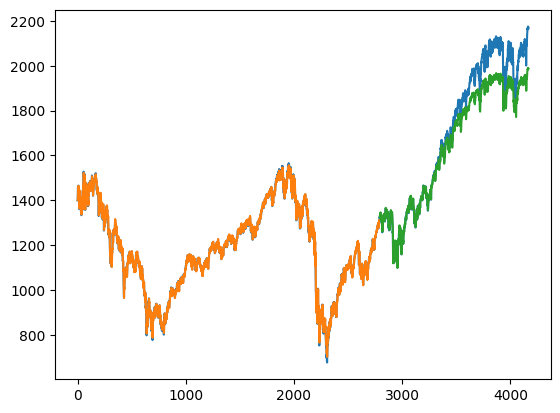

In [ ]:
trainPredictPlot = np.empty_like(dataset)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[look_back:len(trainPredict)+look_back, :] = trainPredict


testPredictPlot = np.empty_like(dataset)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(trainPredict)+(look_back*2)+1:len(dataset)-1, :] = testPredict


plt.plot(scaler.inverse_transform(dataset))
plt.plot(trainPredictPlot)
plt.plot(testPredictPlot)
plt.show()

## **Part III**

In this part we are going to cover the search algorithms. First let's start with the A* search.

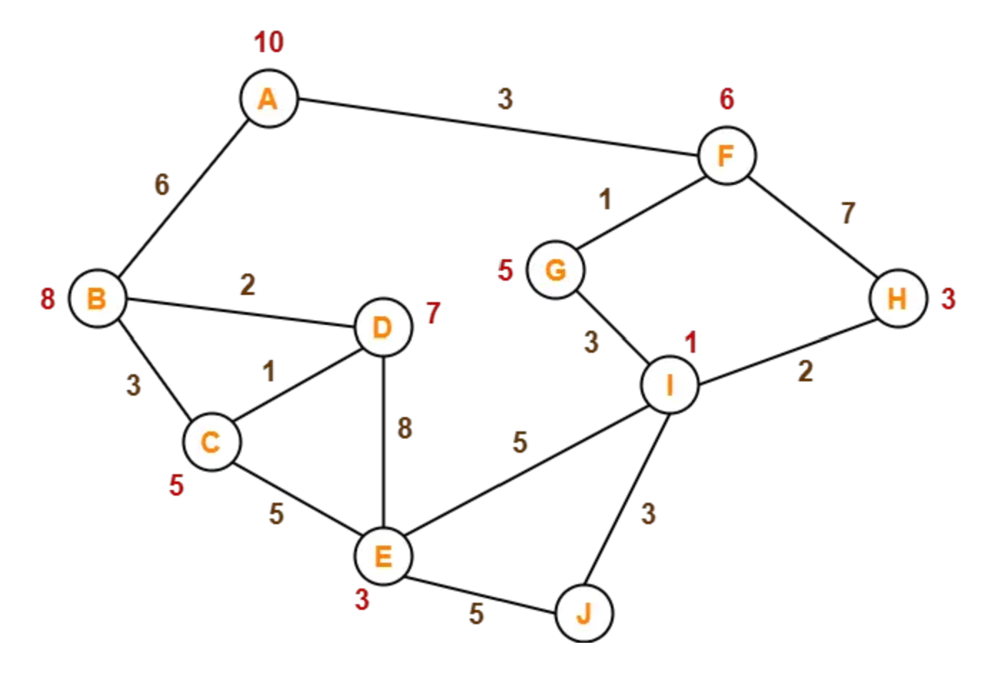

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/A1.png',width=600,height=400)

In this basic example we are looking for the best path between node A and J. The numbers on the edges are the distance between two nodes and the numbers on the nodes are heuristic values. In each step this algorithm will choose the node that distance of reaching it + it's heuristic is the lowest.

Node B and Node F can be reached from node A.

A* Algorithm calculates f(B) and f(F).

f(B) = 6 + 8 = 14
f(F) = 3 + 6 = 9

Since f(F) < f(B), so it decides to go to node F.

Node G and Node H can be reached from node F.

f(G) = (3+1) + 5 = 9
f(H) = (3+7) + 3 = 13


Since f(G) < f(H), so it decides to go to node G.

Node I can be reached from node G.

f(I) = (3+1+3) + 1 = 8

It decides to go to node I.

Path- A → F → G → I

Node E, Node H and Node J can be reached from node I.

f(E) = (3+1+3+5) + 3 = 15
f(H) = (3+1+3+2) + 3 = 12
f(J) = (3+1+3+3) + 0 = 10


Since f(J) is least, so it decides to go to node J.


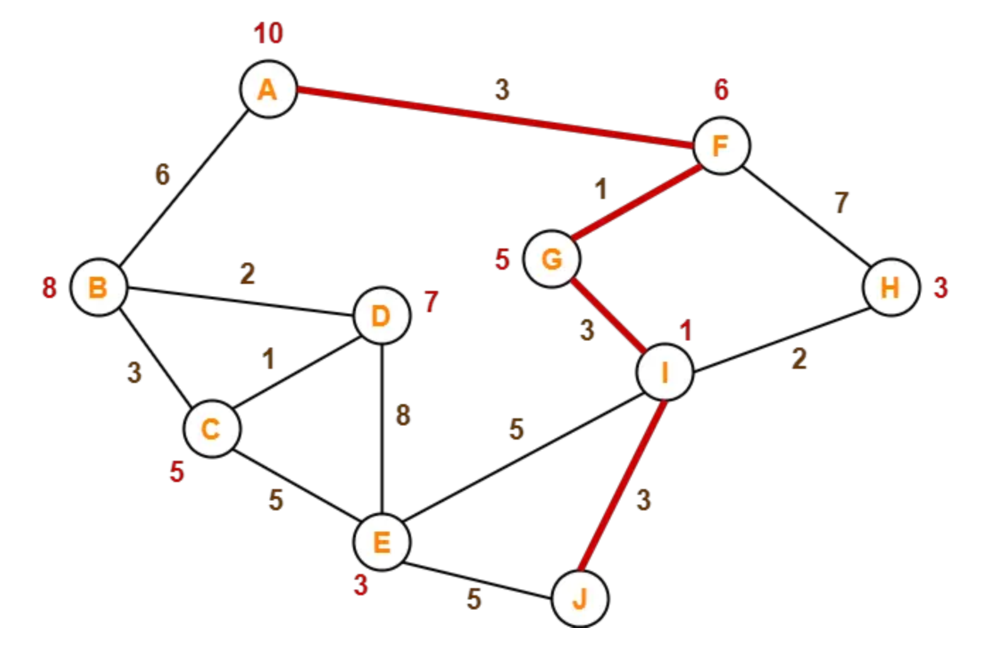

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/A2.png',width=600,height=400)

The implementation:

In [ ]:
import heapq

graph = {
    'A': {'B': 6,  'F': 3},
    'B': {'A': 6, 'C': 3, 'D': 2},
    'C': {'B': 3, 'D': 1, 'E': 5},
    'D': {'B': 2, 'C': 1, 'E': 8},
    'E': {'C': 5, 'D': 8,  'J': 5,'I': 5},
    'F': {'A': 3, 'G': 1, 'H': 7},
    'G': {'F': 1, 'I': 3},
    'H': {'F': 7, 'I': 2},
    'I': {'E': 5, 'G': 3, 'H': 2, 'J': 3},
    'J': {'E': 5, 'I': 3}
}

heuristics = {
    'A': 10,
    'B': 8,
    'C': 5,
    'D': 7,
    'E': 3,
    'F': 6,
    'G': 5,
    'H': 3,
    'I': 1,
    'J': 0
}

def a_star_search(graph, heuristics, start, goal):
    open_list = []
    heapq.heappush(open_list, (0, start))
    came_from = {}
    g_score = {node: float('inf') for node in graph}
    g_score[start] = 0
    f_score = {node: float('inf') for node in graph}
    f_score[start] = heuristics[start]

    while open_list:
        current = heapq.heappop(open_list)[1]

        if current == goal:
            path = []
            while current in came_from:
                path.append(current)
                current = came_from[current]
            path.append(start)
            path.reverse()
            return path

        for neighbor, cost in graph[current].items():
            tentative_g_score = g_score[current] + cost
            if tentative_g_score < g_score[neighbor]:
                came_from[neighbor] = current
                g_score[neighbor] = tentative_g_score
                f_score[neighbor] = tentative_g_score + heuristics[neighbor]
                heapq.heappush(open_list, (f_score[neighbor], neighbor))

    return []

start = 'A'
goal = 'J'
path = a_star_search(graph, heuristics, start, goal)
print("Path:", path)


Path: ['A', 'F', 'G', 'I', 'J']


In [ ]:
import heapq

graph = {
    'A': {'B': 6,  'F': 3},
    'B': {'A': 6, 'C': 3, 'D': 2},
    'C': {'B': 3, 'D': 1, 'E': 5},
    'D': {'B': 2, 'C': 1, 'E': 8},
    'E': {'C': 5, 'D': 8,  'J': 5},
    'F': {'A': 3, 'G': 1, 'H': 7},
    'G': {'F': 1, 'I': 3},
    'H': {'F': 7, 'I': 2},
    'I': { 'G': 3, 'H': 2},
    'J': {'E': 5}
}

heuristics = {
    'A': 10,
    'B': 8,
    'C': 5,
    'D': 7,
    'E': 3,
    'F': 6,
    'G': 5,
    'H': 3,
    'I': 1,
    'J': 0
}

def a_star_search(graph, heuristics, start, goal):
    open_list = []
    heapq.heappush(open_list, (0, start))
    came_from = {}
    g_score = {node: float('inf') for node in graph}
    g_score[start] = 0
    f_score = {node: float('inf') for node in graph}
    f_score[start] = heuristics[start]

    while open_list:
        current = heapq.heappop(open_list)[1]

        if current == goal:
            path = []
            while current in came_from:
                path.append(current)
                current = came_from[current]
            path.append(start)
            path.reverse()
            return path

        for neighbor, cost in graph[current].items():
            tentative_g_score = g_score[current] + cost
            if tentative_g_score < g_score[neighbor]:
                came_from[neighbor] = current
                g_score[neighbor] = tentative_g_score
                f_score[neighbor] = tentative_g_score + heuristics[neighbor]
                heapq.heappush(open_list, (f_score[neighbor], neighbor))

    return []

start = 'A'
goal = 'J'
path = a_star_search(graph, heuristics, start, goal)
print("Path:", path)


Path: ['A', 'B', 'C', 'E', 'J']


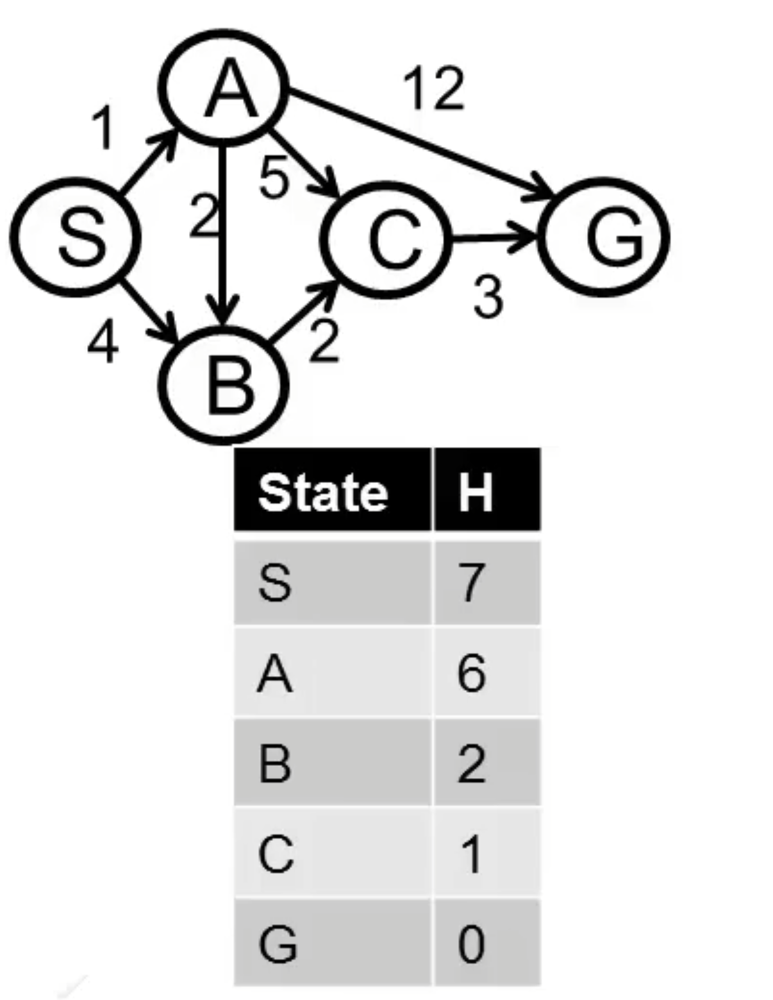

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/A3.png',width=400,height=600)

In [ ]:
import heapq

graph = {
    'S': {'B': 4,  'A': 1},
    'A': {'B': 2, 'C': 5, 'G': 12},
    'B': {'C': 2},
    'C': {'G': 3},
    'G': {},

}

heuristics = {
    'S': 7,
    'A': 6,
    'B': 2,
    'C': 1,
    'G': 0
}

def a_star_search(graph, heuristics, start, goal):
    open_list = []
    heapq.heappush(open_list, (0, start))
    came_from = {}
    g_score = {node: float('inf') for node in graph}
    g_score[start] = 0
    f_score = {node: float('inf') for node in graph}
    f_score[start] = heuristics[start]

    while open_list:
        current = heapq.heappop(open_list)[1]

        if current == goal:
            path = []
            while current in came_from:
                path.append(current)
                current = came_from[current]
            path.append(start)
            path.reverse()
            return path

        for neighbor, cost in graph[current].items():
            tentative_g_score = g_score[current] + cost
            if tentative_g_score < g_score[neighbor]:
                came_from[neighbor] = current
                g_score[neighbor] = tentative_g_score
                f_score[neighbor] = tentative_g_score + heuristics[neighbor]
                heapq.heappush(open_list, (f_score[neighbor], neighbor))

    return []

start = 'S'
goal = 'G'
path = a_star_search(graph, heuristics, start, goal)
print("Path:", path)


Path: ['S', 'A', 'B', 'C', 'G']


As we can see we can input any graph or tree, one sided or two side into this code, and find how the A* search algorithm will work.

Now let's see how min-max algorithm works in a 2 player game.

Look at the tree of this game.

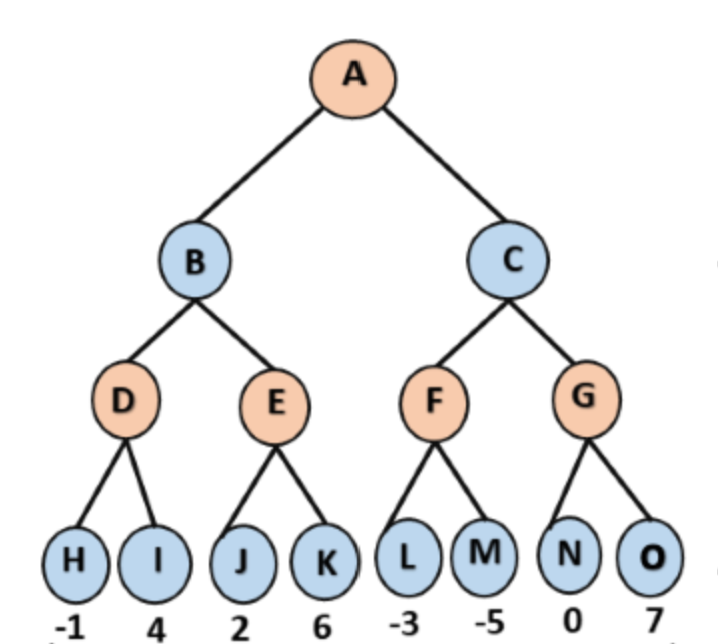

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/minmax1.png',width=400,height=400)

As the name suggests in min max tree layers in tree are changing between maximizing and minimizing alternatively. Suppose you are playing a chess game. In your turns you try to maximize the final score as the opponent in his turn try to minimize your score. In the tree above, Blue is the opponent turn and orange is our turn. Now we are in the A position and we want choose whether we should play left side or the right side for the best outcome in the end. Coming back from the leaves, we know that in the leaves it's opponent turn so last turn was ours. In our turn we pick the best outcome so the maximum value between two brother leaves will pass to their parents. However in B and C nodes it's opponent turn and he will pass the minimum value of the children of each node.

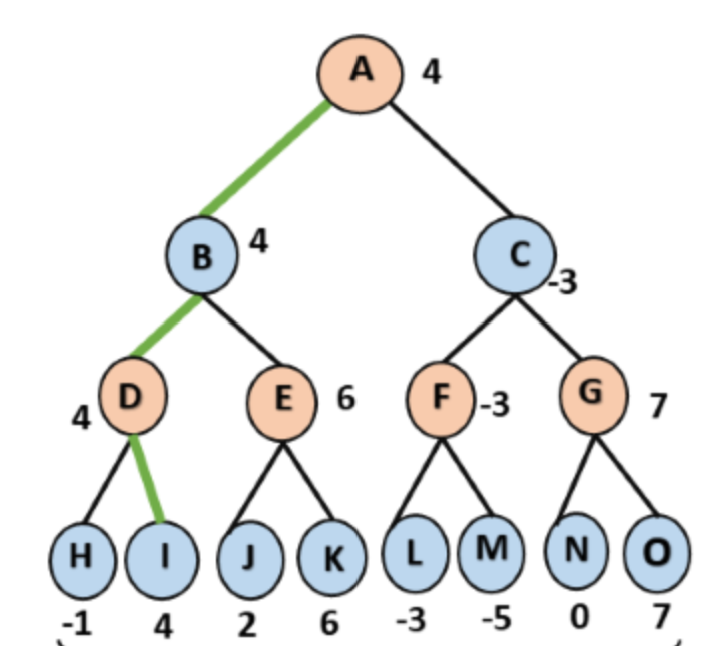

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/minmax12.png',width=400,height=400)

In [ ]:
tree = {
    'A': ['B', 'C'],
    'B': ['D', 'E'],
    'C': ['F', 'G'],
    'D': ['H', 'I'],
    'E': ['J', 'K'],
    'F': ['L', 'M'],
    'G': ['N', 'O'],
    'H': -1,
    'I': 4,
    'J': 2,
    'K': 6,
    'L': -3,
    'M': -5,
    'N': 0,
    'O': 7
}

def minimax(node, depth, is_maximizing_player):
    if isinstance(tree[node], int):
        return tree[node], [node]

    if is_maximizing_player:
        best_value = float('-inf')
        best_path = []
        for child in tree[node]:
            value, path = minimax(child, depth + 1, False)
            if value > best_value:
                best_value = value
                best_path = [node] + path
        return best_value, best_path
    else:
        best_value = float('inf')
        best_path = []
        for child in tree[node]:
            value, path = minimax(child, depth + 1, True)
            if value < best_value:
                best_value = value
                best_path = [node] + path
        return best_value, best_path
def get_leaf_values(node):
    if isinstance(tree[node], int):
        return [tree[node]]

    leaf_values = []
    for child in tree[node]:
        leaf_values.extend(get_leaf_values(child))
    return leaf_values

optimal_value, optimal_path = minimax('A', 0, True)
print("Optimal value using Minimax algorithm:", optimal_value)
print("Path to reach optimal value:", ' -> '.join(optimal_path))


Optimal value using Minimax algorithm: 4
Path to reach optimal value: A -> B -> D -> I


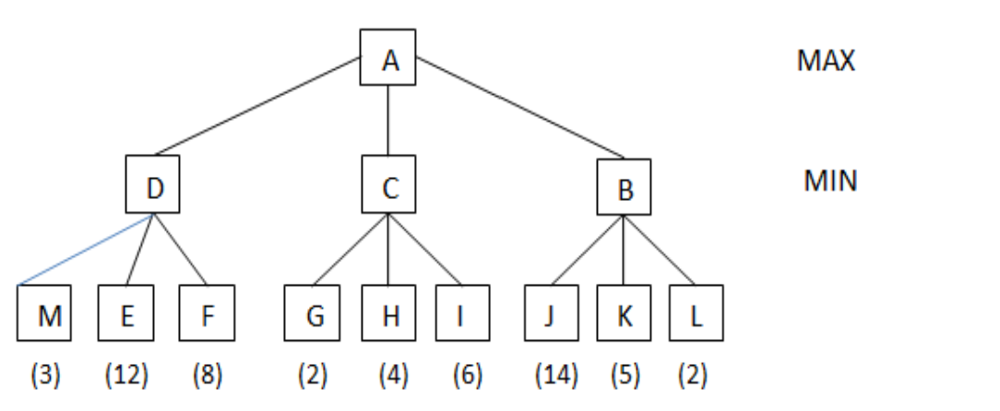

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/minmax2.png',width=600,height=300)

In [ ]:
tree = {
    'A': ['B', 'C','D'],
    'D': ['M', 'E','F'],
    'C': ['G', 'H','I'],
    'B': ['J', 'K', 'L'],
    'M': 3,
    'E': 12,
    'F': 8,
    'G': 2,
    'H': 4,
    'I': 6,
    'J': 14,
    'K': 5,
    'L': 2
}

def minimax(node, depth, is_maximizing_player):
    if isinstance(tree[node], int):
        return tree[node], [node]

    if is_maximizing_player:
        best_value = float('-inf')
        best_path = []
        for child in tree[node]:
            value, path = minimax(child, depth + 1, False)
            if value > best_value:
                best_value = value
                best_path = [node] + path
        return best_value, best_path
    else:
        best_value = float('inf')
        best_path = []
        for child in tree[node]:
            value, path = minimax(child, depth + 1, True)
            if value < best_value:
                best_value = value
                best_path = [node] + path
        return best_value, best_path
def get_leaf_values(node):
    if isinstance(tree[node], int):
        return [tree[node]]

    leaf_values = []
    for child in tree[node]:
        leaf_values.extend(get_leaf_values(child))
    return leaf_values

optimal_value, optimal_path = minimax('A', 0, True)
print("Optimal value using Minimax algorithm:", optimal_value)
print("Path to reach optimal value:", ' -> '.join(optimal_path))


Optimal value using Minimax algorithm: 3
Path to reach optimal value: A -> D -> M


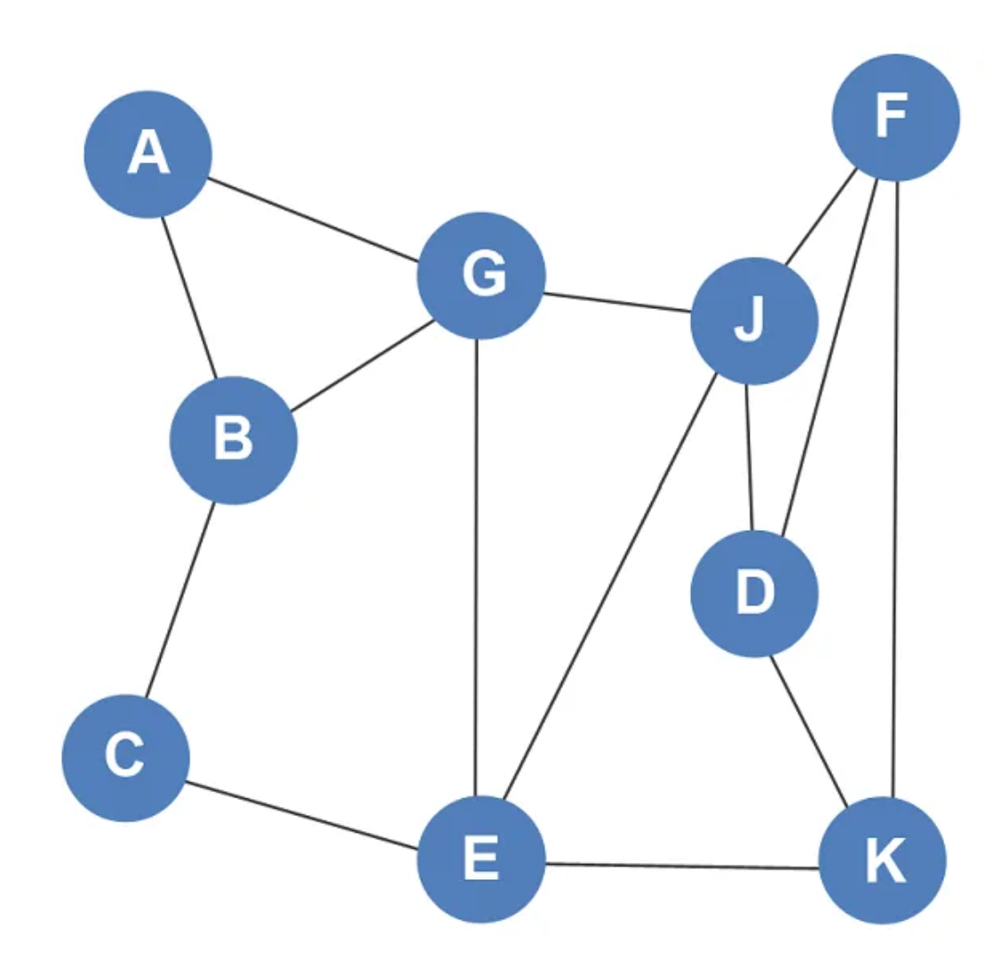

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/BFS.png',width=600,height=600)

In [ ]:
from collections import deque

graph = {
    'A': {'B', 'G'},
    'B': {'C', 'A', 'G'},
    'C': {'B', 'E'},
    'D': {'J', 'F', 'K'},
    'E': {'C', 'G', 'J', 'K'},
    'F': {'J', 'D', 'K'},
    'G': {'A', 'B', 'E', 'J'},
    'J': {'D', 'E', 'F', 'G'},
    'K': {'D', 'E', 'F'}
}

def bfs_search(graph, start, goal):
    queue = deque([(start, [])])
    visited = set()

    while queue:
        current_node, path = queue.popleft()
        if current_node == goal:
            return path + [current_node]
        if current_node in visited:
            continue

        visited.add(current_node)
        print("Visiting node:", current_node)
        for neighbor in graph[current_node]:
            if neighbor not in visited:
                queue.append((neighbor, path + [current_node]))

    return None

start = 'A'
goal = 'K'
path = bfs_search(graph, start, goal)
print("Path:", " -> ".join(path) if path else "No path found")


Visiting node: A
Visiting node: G
Visiting node: B
Visiting node: J
Visiting node: E
Visiting node: C
Visiting node: F
Visiting node: D
Path: A -> G -> E -> K


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


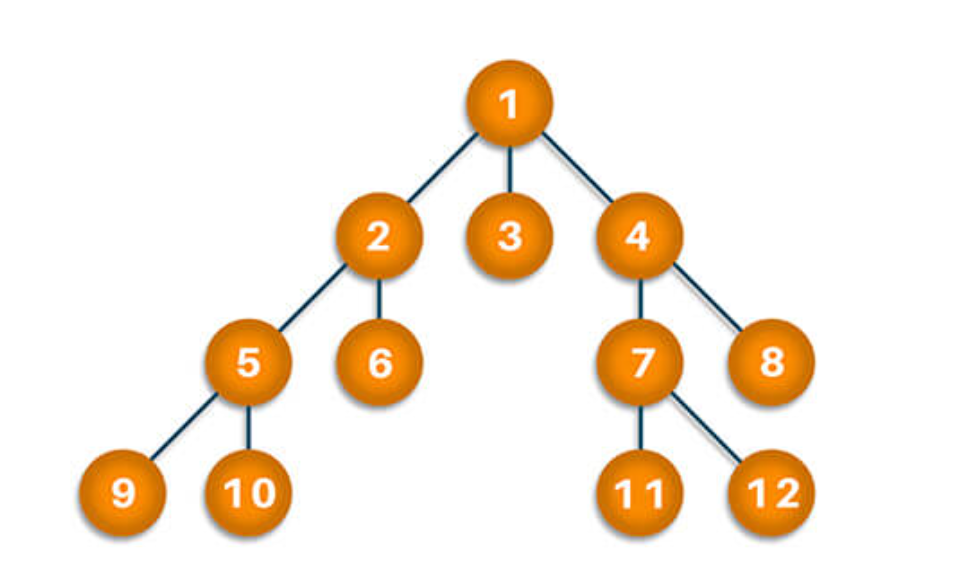

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/DFS.png',width=600,height=400)

In [ ]:
graph = {
    1: [2, 3, 4],
    2: [5, 6],
    3: [],
    4: [7, 8],
    5: [9, 10],
    6: [],
    7: [11, 12],
    8: [],
    9: [],
    10: [],
    11: [],
    12: []
}

def dfs(graph, start, goal, path=None, visited=None):
    if path is None:
        path = []
    if visited is None:
        visited = []

    path.append(start)

    visited.append(start)
    print("Visiting node:", start)

    if start == goal:
        return path

    for neighbor in graph[start]:
        if neighbor not in visited:
            result = dfs(graph, neighbor, goal, path, visited)
            if result is not None:
                return result

    path.pop()
    return None


start = 1
goal = 11
path = dfs(graph, start, goal)

print("Path from {} to {}: {}".format(start, goal, " -> ".join(map(str, path)) if path else "No path found"))


Visiting node: 1
Visiting node: 2
Visiting node: 5
Visiting node: 9
Visiting node: 10
Visiting node: 6
Visiting node: 3
Visiting node: 4
Visiting node: 7
Visiting node: 11
Path from 1 to 11: 1 -> 4 -> 7 -> 11


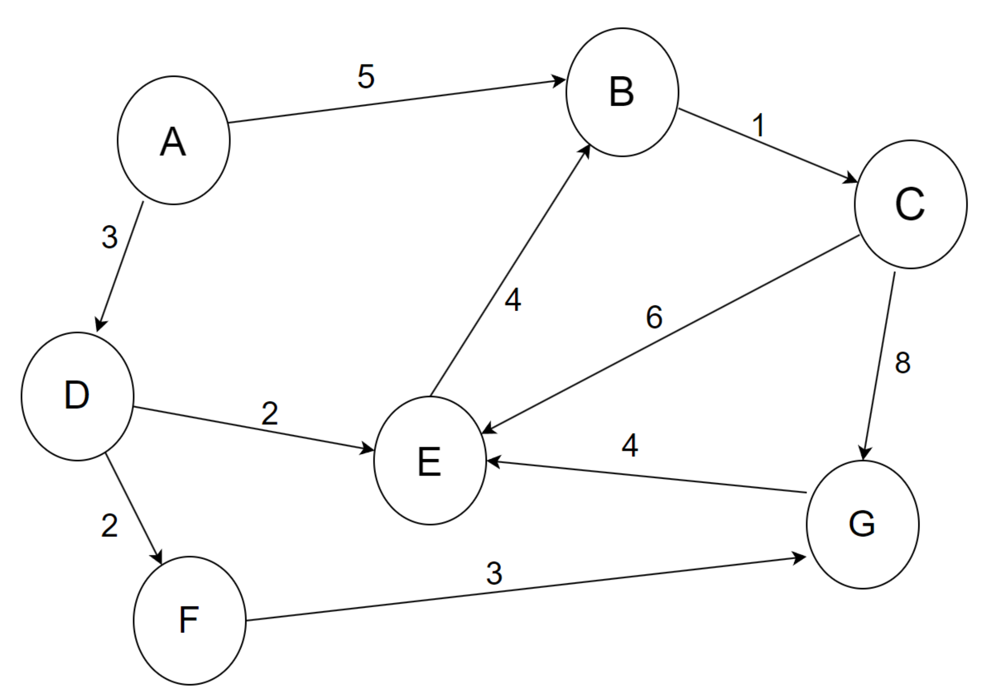

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Project3/UCS.png',width=600,height=500)

In [ ]:
import heapq

graph = {
    'A': {'B': 5, 'D': 3},
    'B': {'C': 1, 'E': 4},
    'C': {'G': 8},
    'D': {'E': 2, 'F': 2},
    'E': {'F': 4, 'G': 6},
    'F': {'G': 3},
    'G': {}
}

def uniform_cost_search(graph, start, goal):
    pq = [(0, start, [])]
    visited = set()

    while pq:
        cost, current_node, path = heapq.heappop(pq)
        if current_node == goal:
            return path + [current_node], cost

        if current_node in visited:
            continue

        visited.add(current_node)
        print("Visiting node:", current_node)

        for neighbor, edge_cost in graph[current_node].items():
            if neighbor not in visited:
                heapq.heappush(pq, (cost + edge_cost, neighbor, path + [current_node]))

    return None, float('inf')

start = 'A'
goal = 'G'
path, cost = uniform_cost_search(graph, start, goal)
print("Path:", " -> ".join(path))
print("Total cost:", cost)


Visiting node: A
Visiting node: D
Visiting node: B
Visiting node: E
Visiting node: F
Visiting node: C
Path: A -> D -> F -> G
Total cost: 8


In [ ]:
pip install simpleai

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 94.4/94.4 kB 2.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for simpleai: filename=simpleai-0.8.3-py3-none-any.whl size=100985 sha256=31c631bd789cc45ca6cc46acc48d1bffee4c81b5ee1624d25a33b46394cfa441
  Stored in directory: /root/.cache/pip/wheels/91/0c/38/421d7910e7bc59b97fc54f490808bdb1097607d83d1a592865
Successfully built simpleai


In [ ]:
from simpleai.search import CspProblem, backtrack

variables = [
    'Mark', 'Julia', 'Brian', 'Steve', 'Amanda', 'Derek',
    'Kelly', 'Allan', 'Michelle', 'Joanne', 'Chris'
]

domains = {
    var: ['Red', 'Green', 'Blue', 'Gray'] for var in variables
}

def constraint_func(names, values):
    return values[0] != values[1]

constraints = [
    (('Mark', 'Julia'), constraint_func),
    (('Mark', 'Steve'), constraint_func),
    (('Julia', 'Amanda'), constraint_func),
    (('Julia', 'Brian'), constraint_func),
    (('Julia', 'Steve'), constraint_func),
    (('Julia', 'Derek'), constraint_func),
    (('Brian', 'Derek'), constraint_func),
    (('Brian', 'Kelly'), constraint_func),
    (('Steve', 'Amanda'), constraint_func),
    (('Steve', 'Allan'), constraint_func),
    (('Steve', 'Michelle'), constraint_func),
    (('Amanda', 'Derek'), constraint_func),
    (('Amanda', 'Michelle'), constraint_func),
    (('Amanda', 'Joanne'), constraint_func),
    (('Derek', 'Kelly'), constraint_func),
    (('Derek', 'Joanne'), constraint_func),
    (('Derek', 'Chris'), constraint_func),
    (('Kelly', 'Chris'), constraint_func),
    (('Allan', 'Michelle'), constraint_func),
    (('Michelle', 'Joanne'), constraint_func),
    (('Joanne', 'Chris'), constraint_func)
]

problem = CspProblem(variables, domains, constraints)

solution = backtrack(problem)

for region, color in solution.items():
    print(f'{region}: {color}')


Mark: Red
Julia: Green
Brian: Red
Steve: Blue
Amanda: Red
Derek: Blue
Kelly: Green
Allan: Red
Michelle: Green
Joanne: Gray
Chris: Red
